### Import necessary libraries
In this first cell, we import the necessary Python libraries for spatial data manipulation, querying OpenStreetMap (OSM) data, and plotting.

In [2]:
# Import necessary libraries
import overpy
import geopandas as gpd
import pandas as pd
from shapely.geometry import Polygon, MultiPolygon, LineString, Point
from shapely.ops import unary_union, linemerge
from shapely.validation import make_valid
from shapely.errors import TopologicalError
import matplotlib.pyplot as plt
import networkx as nx
import math
%matplotlib widget

### Helper functions
We define some key helper functions used in processing building geometries and calculating the midpoints of building facades.

In [3]:
# Helper function to close small gaps between lines
def close_small_gaps(line, tolerance=0.0001):
    if line.is_ring:  # Already closed
        return line
    # Check if the start and end points are within the tolerance
    if line.coords[0] != line.coords[-1]:
        start = line.coords[0]
        end = line.coords[-1]
        if LineString([start, end]).length <= tolerance:
            coords = list(line.coords)
            coords[-1] = start
            return LineString(coords)
    return line

# Function to get facade midpoints for each building's polygon
def get_facade_midpoints_per_building(geometry, building_id):
    midpoints = []
    
    # Handle MultiPolygon by iterating over each Polygon
    if geometry.geom_type == 'MultiPolygon':
        for polygon in geometry.geoms:
            exterior_coords = list(polygon.exterior.coords)
            
            # Process each edge of the polygon and compute its midpoint
            for i in range(len(exterior_coords) - 1):
                p1 = exterior_coords[i]
                p2 = exterior_coords[i + 1]
                
                # Create midpoint
                midpoint = Point((p1[0] + p2[0]) / 2, (p1[1] + p2[1]) / 2)
                
                # Store facade midpoint data
                midpoints.append({
                    'building_id': building_id, 
                    'geometry': midpoint, 
                    'facade_index': i
                })
    # Handle single Polygon
    elif geometry.geom_type == 'Polygon':
        exterior_coords = list(geometry.exterior.coords)
        
        # Process each edge of the polygon and compute its midpoint
        for i in range(len(exterior_coords) - 1):
            p1 = exterior_coords[i]
            p2 = exterior_coords[i + 1]
            
            # Create midpoint
            midpoint = Point((p1[0] + p2[0]) / 2, (p1[1] + p2[1]) / 2)
            
            # Store facade midpoint data
            midpoints.append({
                'building_id': building_id, 
                'geometry': midpoint, 
                'facade_index': i
            })
    
    return midpoints


# Function to process OSM building elements and extract geometries
def process_building(element):
    outer_ways, inner_ways = [], []  # Initialize as two empty lists
    
    # Process relations
    if isinstance(element, overpy.Relation):
        for member in element.members:
            if isinstance(member, (overpy.Way, overpy.RelationWay)): 
                if member.role == 'outer':
                    outer_ways.append(member)
                elif member.role == 'inner':
                    inner_ways.append(member)

        if not outer_ways:
            return None  # Skip if no outer ways

        outer_polygons, outer_lines = [], []
        for outer_way in outer_ways:
            if isinstance(outer_way, overpy.RelationWay):
                outer_way = outer_way.resolve()

            nodes = [(float(node.lon), float(node.lat)) for node in outer_way.nodes]
            if len(nodes) >= 2:
                line = LineString(nodes)
                outer_lines.append(line)

        try:
            merged_line = linemerge(outer_lines)
            if isinstance(merged_line, LineString):
                merged_line = close_small_gaps(merged_line)
                if merged_line.is_ring:
                    outer_polygon = Polygon(merged_line)
                    if outer_polygon.is_valid:
                        outer_polygons.append(outer_polygon)
                    else:
                        outer_polygon = make_valid(outer_polygon)
                        if outer_polygon.is_valid:
                            outer_polygons.append(outer_polygon)
            elif isinstance(merged_line, MultiPolygon):
                outer_polygons = list(merged_line.geoms)
            else:
                outer_polygons = [Polygon(line) for line in outer_lines if line.is_ring and Polygon(line).is_valid]
        except TopologicalError as e:
            outer_polygons = [Polygon(line) for line in outer_lines if line.is_ring and Polygon(line).is_valid]

        if not outer_polygons:
            return None

        if len(outer_polygons) > 1:
            geometry = max(outer_polygons, key=lambda p: p.area)
        else:
            geometry = outer_polygons[0]

        # Add holes (inner polygons)
        inner_polygons = []
        for inner_way in inner_ways:
            if isinstance(inner_way, overpy.RelationWay):
                inner_way = inner_way.resolve()

            nodes = [(float(node.lon), float(node.lat)) for node in inner_way.nodes]
            if len(nodes) >= 4:
                if nodes[0] != nodes[-1]:
                    nodes.append(nodes[0])
                inner_polygon = Polygon(nodes)
                if inner_polygon.is_valid:
                    inner_polygons.append(inner_polygon)

        try:
            geometry = Polygon(geometry.exterior.coords, holes=[inner.exterior.coords for inner in inner_polygons if geometry.contains(inner)])
        except TopologicalError as e:
            return None

        if not geometry.is_valid:
            geometry = geometry.buffer(0)
            if not geometry.is_valid:
                return None

    # Simple polygons (for ways)
    else:
        nodes = [(float(node.lon), float(node.lat)) for node in element.nodes]
        if len(nodes) >= 4:
            if nodes[0] != nodes[-1]:
                nodes.append(nodes[0])
            try:
                geometry = Polygon(nodes)
                if not geometry.is_valid:
                    geometry = geometry.buffer(0)
                    if not geometry.is_valid:
                        return None
            except TopologicalError as e:
                return None
        else:
            return None

    height = element.tags.get('height')
    levels = element.tags.get('building:levels')
    building_type = element.tags.get('building')
    name = element.tags.get('name')

    if height:
        try:
            height = float(height)
        except ValueError:
            height = None

    return {
        'osm_id': element.id,
        'geometry': geometry,
        'height': height,
        'levels': levels,
        'building_type': building_type,
        'name': name
    }

close_small_gaps: This function ensures that small gaps between lines are closed. It checks whether the start and end of a line are within a given tolerance and closes the gap if necessary.

process_building: Process of all buildings by properly handlying polygons and multypoligons, as well as situations in which in one relation more than one detached building is present.

get_facade_midpoints_per_building: Given a building polygon, this function calculates and returns the midpoints of each facade (edge) of the building.

### Querying OSM Data
We use Overpass API to query OpenStreetMap for building data within a bounding box of interest.

In [4]:
# Query OSM and process building data using bounding box
lat_min, lon_min, lat_max, lon_max = 44.805803,10.328752,44.807306,10.332336

api = overpy.Overpass()

# Modify query to use bounding box (bbox)
query = f"""
[out:json][timeout:180];
(
  way["building"]({lat_min},{lon_min},{lat_max},{lon_max});
  relation["building"]({lat_min},{lon_min},{lat_max},{lon_max});
);
out body;
>;
out skel qt;
"""
result = api.query(query)

buildings = []
for element in result.ways + result.relations:
    if 'building' in element.tags:
        building_data = process_building(element)
        if building_data:
            buildings.append(building_data)


We query building data from OSM using the Overpass API for a specific geographical area defined by latitude and longitude coordinates.

The result includes ways and relations representing buildings.

### Processing Building Data
Now that we have building data, we process the results into a GeoDataFrame and prepare the data for further spatial analysis.

In [5]:
# Create a GeoDataFrame for building footprints
gdf = gpd.GeoDataFrame(buildings, crs="EPSG:4326")

# Filter for valid geometries
gdf = gdf[gdf.geometry.is_valid]

# Reproject to target CRS (EPSG:7791 - RDN2008 / UTM zone 32N)
target_crs = "EPSG:7791"
gdf_projected = gdf.to_crs(target_crs)

# Filter out small buildings (e.g., less than 10 square meters)
min_area = 10  # in square meters
gdf_projected = gdf_projected[gdf_projected.geometry.area > min_area]

In [6]:
gdf_projected

,osm_id,geometry,height,levels,building_type,name
0,182136568,"POLYGON ((605329.256 4962223.562, 605344.631 4...",None,None,yes,None
1,182136570,"POLYGON ((605272.36 4962301.154, 605277.674 49...",None,None,yes,None
2,182136574,"POLYGON ((605260.612 4962306.529, 605264.423 4...",None,None,yes,None
3,182136591,"POLYGON ((605149.545 4962296.411, 605158.416 4...",None,None,yes,None
4,182136595,"POLYGON ((605135.491 4962382.839, 605137.991 4...",None,None,yes,None
...,...,...,...,...,...,...
180,2427080,"POLYGON ((605123.12 4962364.469, 605127.555 49...",None,None,yes,None
181,2427082,"POLYGON ((605298.885 4962237.254, 605302.882 4...",None,None,yes,Casa Cordero già Piazza
182,2427083,"POLYGON ((605224.053 4962322.842, 605228.427 4...",None,None,yes,None
183,2427090,"POLYGON ((605228.602 4962261.47, 605238.601 49...",None,None,yes,None


<Axes: >

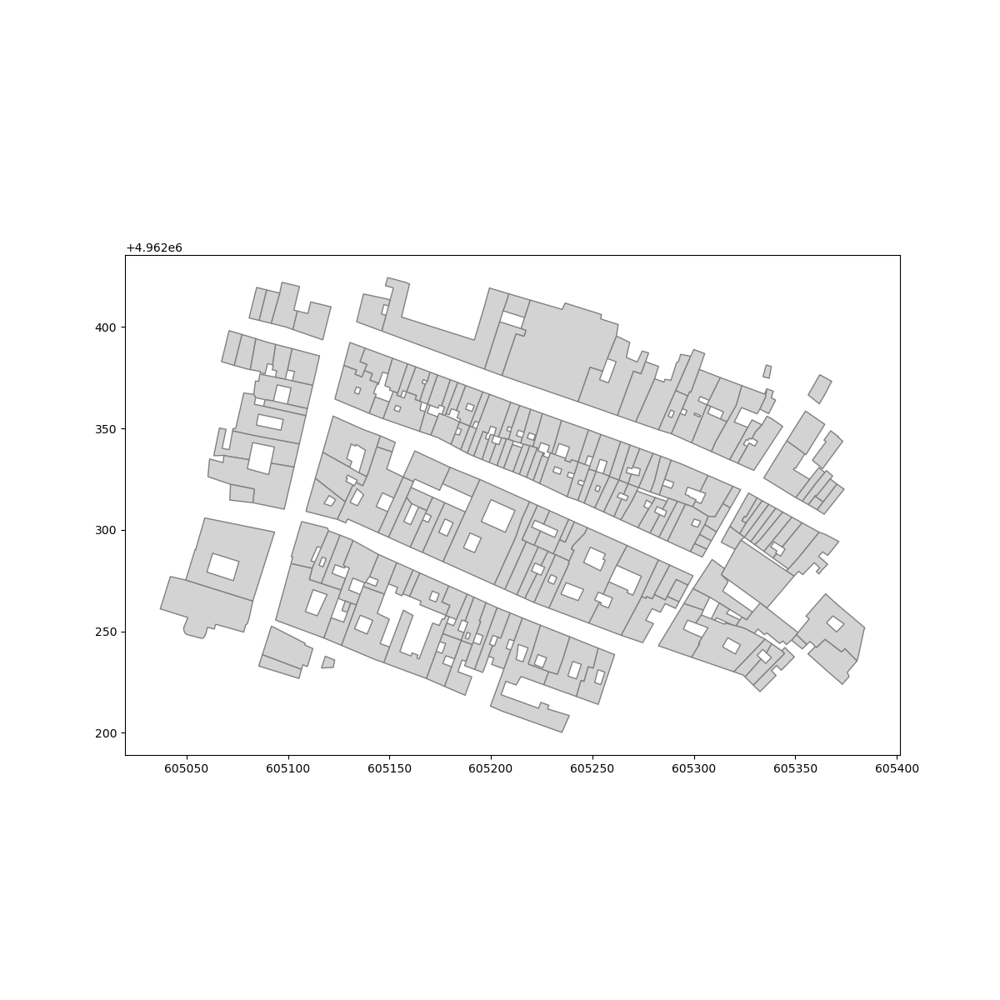

In [7]:
# Plot to verify midpoints per building
fig, ax = plt.subplots(figsize=(12, 12))

# Plot all building footprints in grey
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')

We store the building data in a GeoDataFrame.

We reproject the data into the EPSG:7791 coordinate system.

We filter out small buildings with an area of less than 10 square meters.

### Remove buildings that could cause problems
Identify builings and create polygons, remove all buildings intersecting polygons

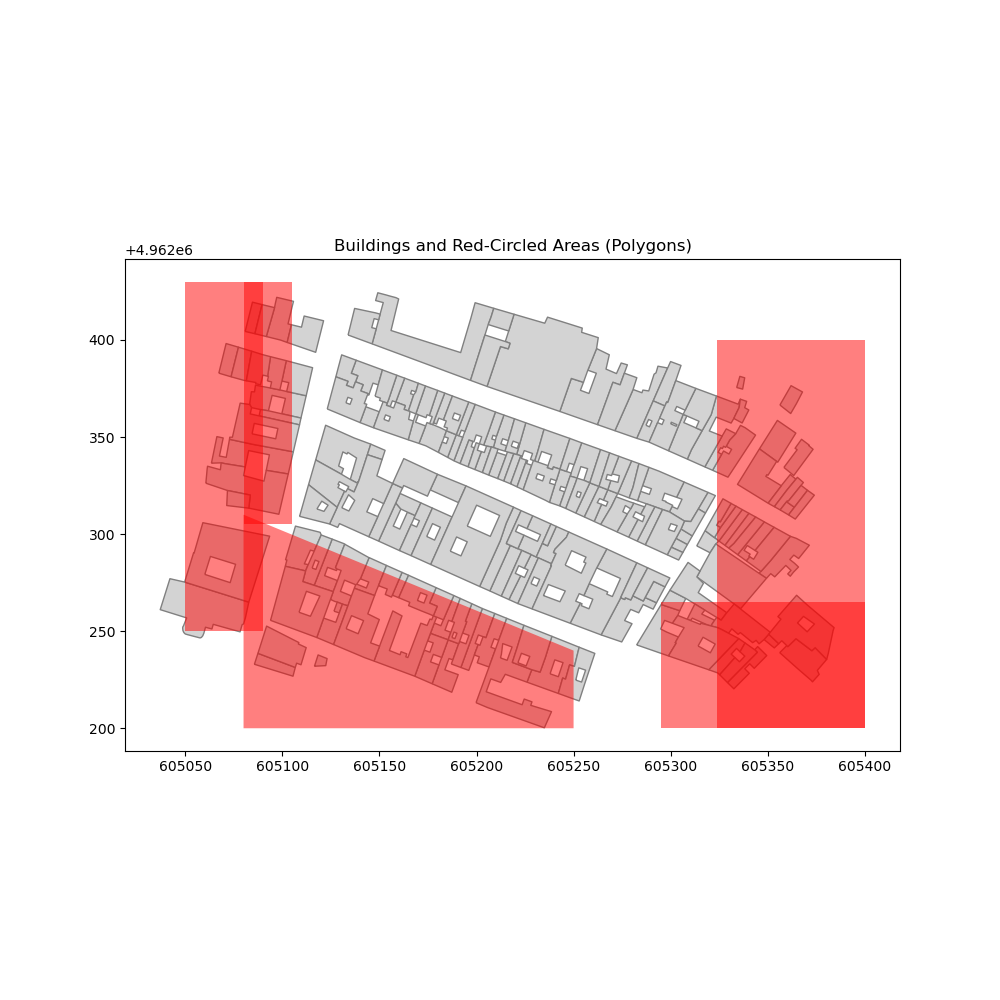

In [8]:
# Example polygons for red-circled areas (replace these with actual coordinates)
polygon_1 = Polygon([(605050, 4962250), (605050, 4962430), (605090, 4962430), (605090, 4962250)])
polygon_2 = Polygon([(605324, 4962200), (605324, 4962400), (605400, 4962400), (605400, 4962200)])
polygon_3 = Polygon([(605080, 4962305), (605080, 4962430), (605105, 4962430), (605105, 4962305)])
polygon_4 = Polygon([(605295, 4962200), (605295, 4962265), (605400, 4962265), (605400, 4962200)])
polygon_5 = Polygon([(605080, 4962200), (605080, 4962310), (605250, 4962240), (605250, 4962200)])

# Create a GeoDataFrame with multiple polygons
gdf_red_circles = gpd.GeoDataFrame(geometry=[polygon_1, polygon_2, polygon_3, polygon_4, polygon_5], crs=gdf_projected.crs)

# Visualize the polygons and the buildings
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the original building GeoDataFrame
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')

# Plot the red-circled areas as polygons
gdf_red_circles.plot(ax=ax, color='red', alpha=0.5)

plt.title("Buildings and Red-Circled Areas (Polygons)")
plt.show()

C:\Users\FedericoBattini\AppData\Local\Temp\ipykernel_23680\3904555827.py:2: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  gdf_filtered = gdf_projected[~gdf_projected.intersects(gdf_red_circles.unary_union)]


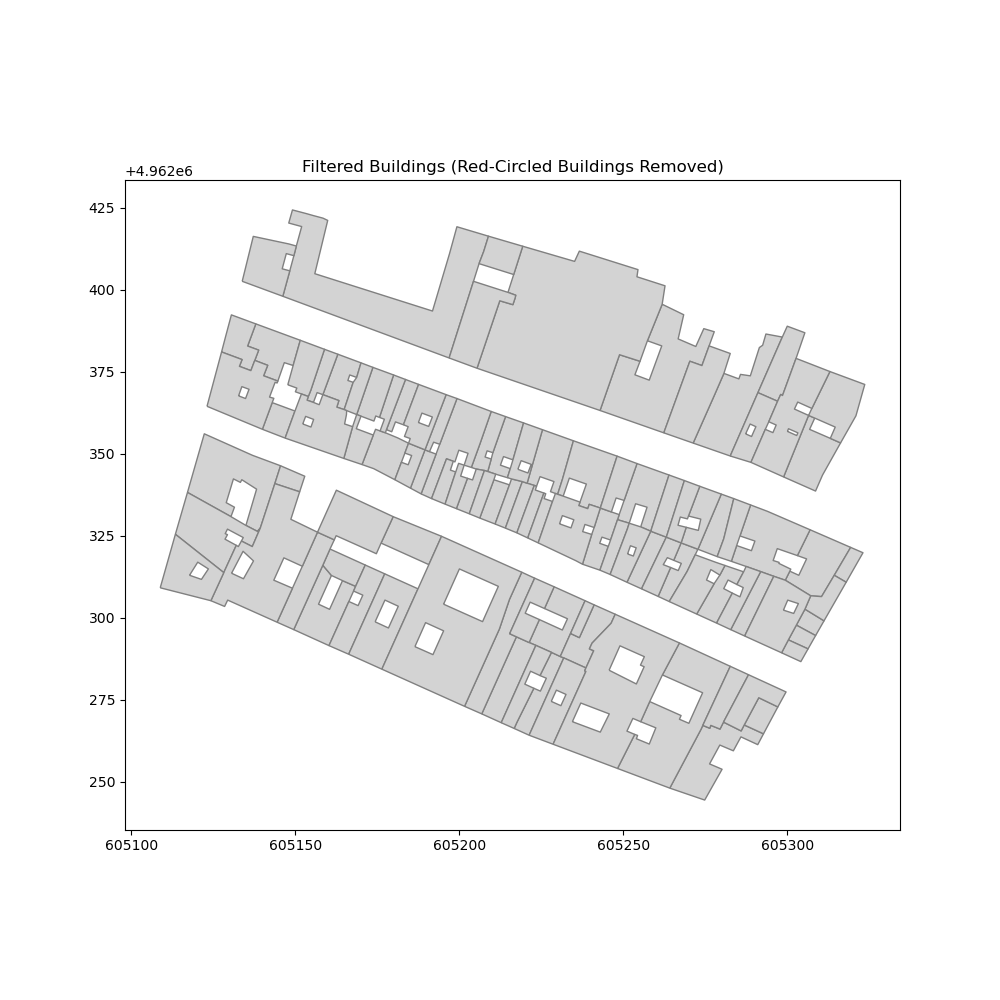

In [9]:
# Perform spatial filtering to remove buildings that intersect with the red-circled areas
gdf_filtered = gdf_projected[~gdf_projected.intersects(gdf_red_circles.unary_union)]

# Visualize the filtered buildings
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the filtered buildings (those that are NOT in the red circles)
gdf_filtered.plot(ax=ax, color='lightgrey', edgecolor='grey')

plt.title("Filtered Buildings (Red-Circled Buildings Removed)")
plt.show()

In [10]:
gdf_projected = gdf_filtered.copy()

### Calculating Facade Midpoints
We calculate the midpoints of the facades for each building.

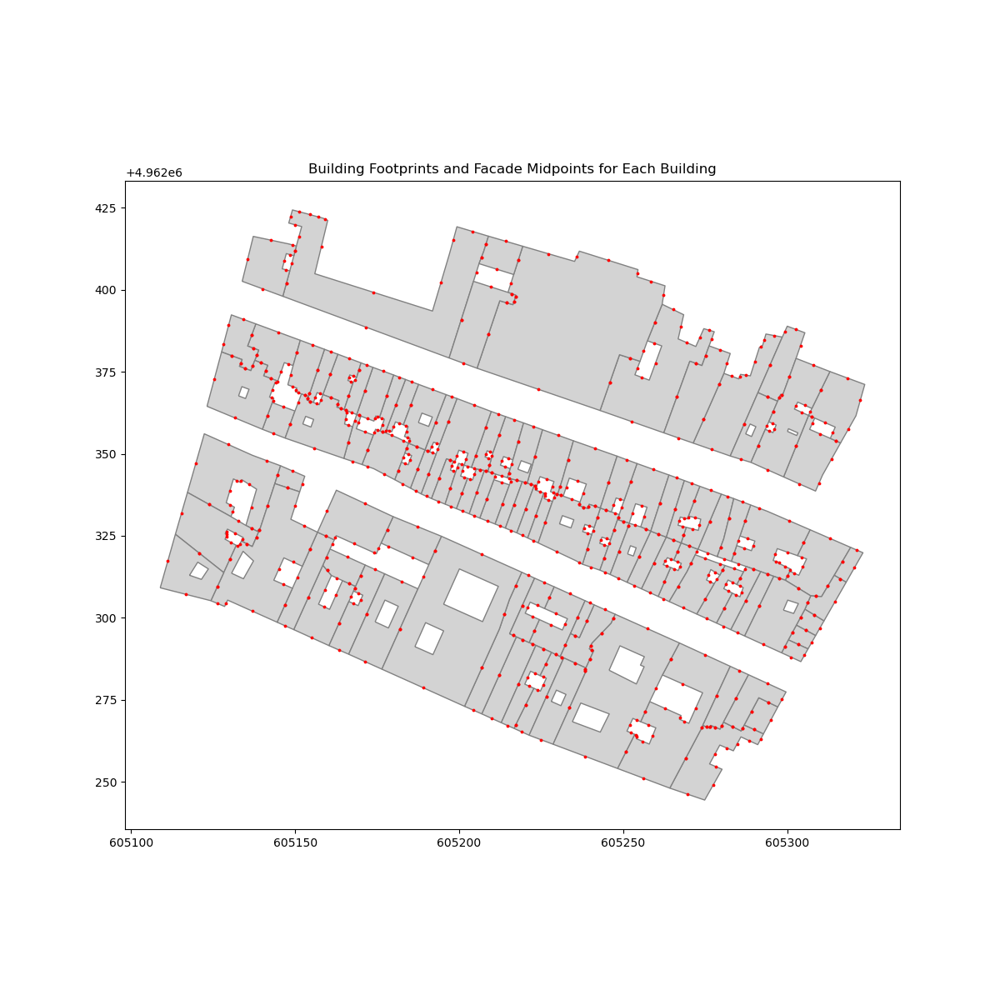

In [11]:
# Process each building footprint separately
facade_midpoints_data = []
for index, row in gdf_projected.iterrows():  # Iterate through rows with index
    building_id = row['osm_id'] if 'osm_id' in gdf_projected.columns else index  # Use OSM ID if available, otherwise use row index
    geometry = row['geometry']
    midpoints = get_facade_midpoints_per_building(geometry, building_id)
    facade_midpoints_data.extend(midpoints)

# Create a GeoDataFrame for facade midpoints
facade_midpoints_gdf = gpd.GeoDataFrame(facade_midpoints_data, crs=gdf_projected.crs)

# Plot to verify midpoints per building
fig, ax = plt.subplots(figsize=(12, 12))

# Plot all building footprints in grey
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')

# Plot facade midpoints in red
facade_midpoints_gdf.plot(ax=ax, color='red', markersize=3)

plt.title("Building Footprints and Facade Midpoints for Each Building")
plt.show()

This section computes the midpoints of each building facade and stores the results in a new GeoDataFrame.

### Analyzing Grouped Buildings
Here we perform spatial analysis to identify groups of adjacent buildings and find exterior boundaries of these groups.

In [12]:
# Parameters
buffer_distance = 0.1  # For joining buildings
min_segment_length = 1.0  # Minimum length for facade segments

# Use spatial join to find touching buildings
gdf_projected['temp_id'] = gdf_projected.index
gdf_buffered = gdf_projected.copy()
gdf_buffered['geometry'] = gdf_projected.geometry.buffer(buffer_distance)
joined_gdf = gpd.sjoin(gdf_buffered, gdf_buffered, how='inner', predicate='intersects')

# Create the graph from the spatial join results
G = nx.Graph()
for _, row in joined_gdf.iterrows():
    G.add_edge(row['temp_id_left'], row['temp_id_right'])

# Find connected components (groups of adjacent buildings)
connected_components = list(nx.connected_components(G))

# Assign group IDs to buildings based on connected components
gdf_projected['group_id'] = None
for group_id, component in enumerate(connected_components):
    if len(component) == 1:
        gdf_projected.loc[list(component), 'group_id'] = f'standalone_{group_id}'
    else:
        gdf_projected.loc[list(component), 'group_id'] = f'block_{group_id}'

We buffer the buildings slightly to join adjacent buildings and use spatial joins to group them into blocks or groups.

A graph is constructed to represent building adjacency, and connected components (groups) are identified.

### Processing and Plotting Exterior Boundaries and Midpoints
Finally, we plot the exterior boundaries and midpoints of building facades.

In [13]:
gdf_projected

,osm_id,geometry,height,levels,building_type,name,temp_id,group_id
1,182136570,"POLYGON ((605272.36 4962301.154, 605277.674 49...",None,None,yes,None,1,block_0
2,182136574,"POLYGON ((605260.612 4962306.529, 605264.423 4...",None,None,yes,None,2,block_0
3,182136591,"POLYGON ((605149.545 4962296.411, 605158.416 4...",None,None,yes,None,3,block_1
4,182136595,"POLYGON ((605135.491 4962382.839, 605137.991 4...",None,None,yes,None,4,block_0
5,182136600,"POLYGON ((605158.427 4962368.024, 605162.988 4...",None,None,yes,None,5,block_0
...,...,...,...,...,...,...,...,...
178,2427076,"POLYGON ((605288.902 4962347.382, 605293.278 4...",None,None,yes,None,178,block_2
180,2427080,"POLYGON ((605123.12 4962364.469, 605127.555 49...",None,None,yes,None,180,block_0
182,2427083,"POLYGON ((605224.053 4962322.842, 605228.427 4...",None,None,yes,None,182,block_0
183,2427090,"POLYGON ((605228.602 4962261.47, 605238.601 49...",None,None,yes,None,183,block_1


In [14]:
# Process each group and identify facade segments along the outer edge, including building IDs
facade_segments = []
exterior_boundaries = []

for group_id, group_gdf in gdf_projected.groupby('group_id'):
    merged_polygon = unary_union(group_gdf['geometry'])
    polygons = list(merged_polygon.geoms) if merged_polygon.geom_type == 'MultiPolygon' else [merged_polygon]

    for polygon in polygons:
        exterior_boundary = polygon.exterior
        exterior_boundaries.append({'group_id': group_id, 'geometry': exterior_boundary})
        
        for i in range(len(exterior_boundary.coords) - 1):
            p1 = exterior_boundary.coords[i]
            p2 = exterior_boundary.coords[i + 1]
            segment = LineString([p1, p2])
            
            if segment.length >= min_segment_length:
                # Find the closest building to this segment
                closest_building = None
                min_distance = float('inf')
                
                for building_id, building in group_gdf.iterrows():
                    distance = building['geometry'].distance(segment.centroid)  # Find distance to the centroid
                    if distance < min_distance:
                        min_distance = distance
                        closest_building = building_id

                # Assign the closest building to this segment
                if closest_building is not None:
                    midpoint = segment.centroid
                    facade_segments.append({
                        'group_id': group_id, 
                        'building_id': closest_building, 
                        'geometry': midpoint
                    })

# Create GeoDataFrames for facade segments and exterior boundaries
facade_segments_gdf = gpd.GeoDataFrame(facade_segments, crs=gdf_projected.crs)
exterior_boundaries_gdf = gpd.GeoDataFrame(exterior_boundaries, crs=gdf_projected.crs)

For each group of buildings, we compute the exterior boundary and the midpoints of building facades that are part of this boundary.

In [15]:
# Save your data as shapefiles and GeoJSONs
data_path = '../data/Street_view/'

# Save as GeoJSON
gdf_projected.to_file(data_path + "Bologna_buildings.geojson", driver="GeoJSON")
exterior_boundaries_gdf.to_file(data_path + "Bologna_exterior_boundaries.geojson", driver="GeoJSON")
facade_segments_gdf.to_file(data_path + "Bologna_facade_segments.geojson", driver="GeoJSON")


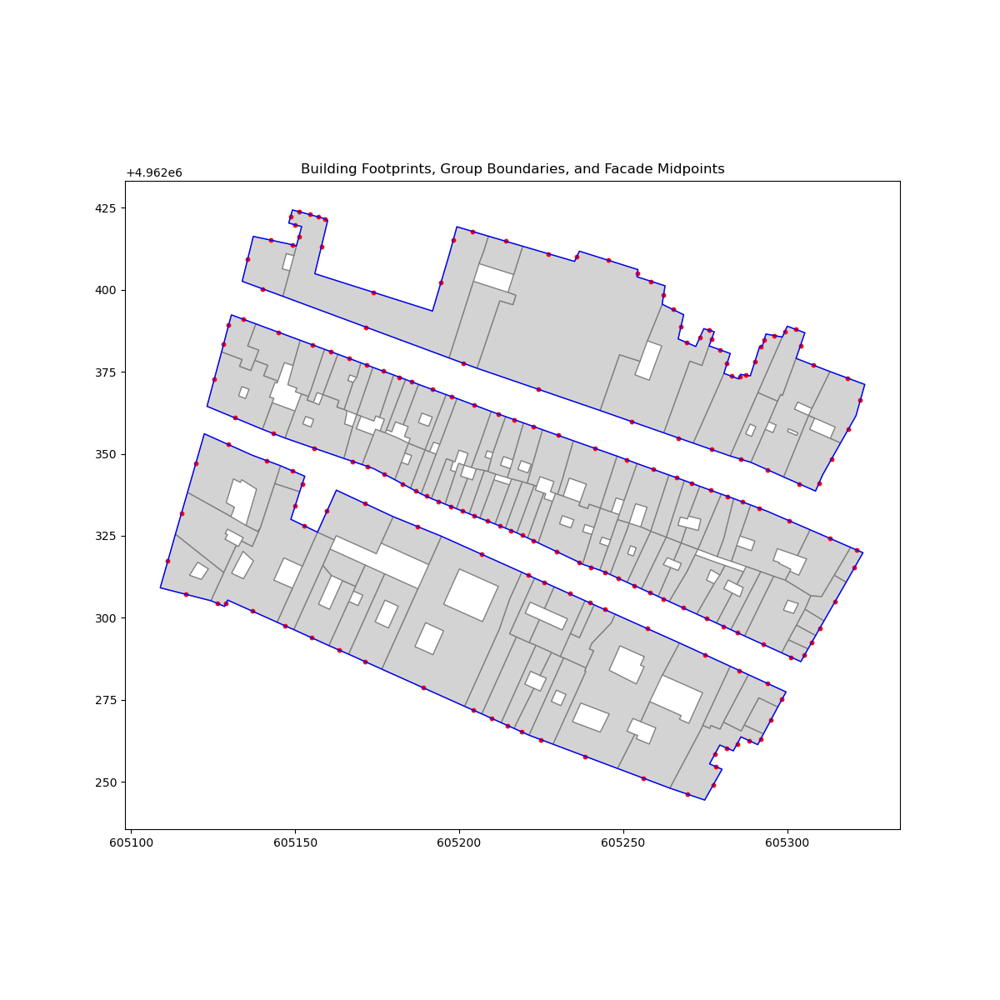

In [16]:
# Plot all buildings, boundaries, and midpoints on one map
fig, ax = plt.subplots(figsize=(12, 12))
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')
exterior_boundaries_gdf.plot(ax=ax, color='blue', linewidth=1)
facade_segments_gdf.plot(ax=ax, color='red', markersize=10)

#cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, zoom=15)
plt.title("Building Footprints, Group Boundaries, and Facade Midpoints")
plt.show()

The final plot shows the buildings, their boundaries, and the calculated facade midpoints.

In [17]:
# Helper function to calculate azimuth between two points
def calculate_azimuth(p1, p2):
    lon1, lat1 = p1
    lon2, lat2 = p2
    # Calculate azimuth as before
    azimuth = math.degrees(math.atan2(lon2 - lon1, lat2 - lat1))
    azimuth = (azimuth + 360) % 360  # Normalize azimuth to [0, 360]

    # Adjust for 90-degree counterclockwise shift
    adjusted_azimuth = (azimuth - 90) % 360

    return adjusted_azimuth


# Function to classify azimuth into cardinal direction with ±45° tolerance
def classify_orientation(azimuth):
    directions = {
        'N': 0,
        'NE': 45,
        'E': 90,
        'SE': 135,
        'S': 180,
        'SW': 225,
        'W': 270,
        'NW': 315
    }
    
    for direction, angle in directions.items():
        if abs(azimuth - angle) <= 45:
            return direction
    return 'N'

# Function to classify azimuth into only N, S, E, W directions with ±45° tolerance
def classify_orientation(azimuth):
    directions = {
        'N': 0,
        'E': 90,
        'S': 180,
        'W': 270
    }
    
    for direction, angle in directions.items():
        if abs(azimuth - angle) <= 45:  # ±45° tolerance for each direction
            return direction
    return 'N'

# Process facade midpoints to assign orientation based on exterior boundaries
def add_orientation_using_exterior_boundaries(facade_segments_gdf, exterior_boundaries_gdf):
    oriented_midpoints = []

    for index, row in facade_segments_gdf.iterrows():
        midpoint = row['geometry']
        group_id = row['group_id']

        # Get the corresponding exterior boundary for this group
        boundary_row = exterior_boundaries_gdf[exterior_boundaries_gdf['group_id'] == group_id]
        if boundary_row.empty:
            continue  # Skip if no matching boundary is found

        boundary = boundary_row.iloc[0]['geometry']  # Get the exterior boundary LINEARRING

        # Iterate over each segment of the exterior boundary
        exterior_coords = list(boundary.coords)
        for i in range(len(exterior_coords) - 1):
            p1 = exterior_coords[i]
            p2 = exterior_coords[i + 1]
            segment = LineString([p1, p2])

            # Check if the midpoint is near the segment (within a small buffer)
            if segment.distance(midpoint) < 1e-6:  # Adjust tolerance as needed
                azimuth = calculate_azimuth(p1, p2)
                orientation = classify_orientation(azimuth)

                # Add the orientation to the midpoint data
                oriented_midpoints.append({
                    'group_id': group_id,
                    'building_id': row['building_id'],
                    'geometry': midpoint,
                    'orientation': orientation
                })
                break  # Once we find the matching segment, we can stop
            
    # Create a new GeoDataFrame with oriented facade midpoints
    oriented_midpoints_gdf = gpd.GeoDataFrame(oriented_midpoints, geometry='geometry', crs=facade_segments_gdf.crs)
    
    return oriented_midpoints_gdf

# Apply the function to classify and add orientation to midpoints based on exterior boundaries
oriented_facade_segments_gdf = add_orientation_using_exterior_boundaries(facade_segments_gdf, exterior_boundaries_gdf)

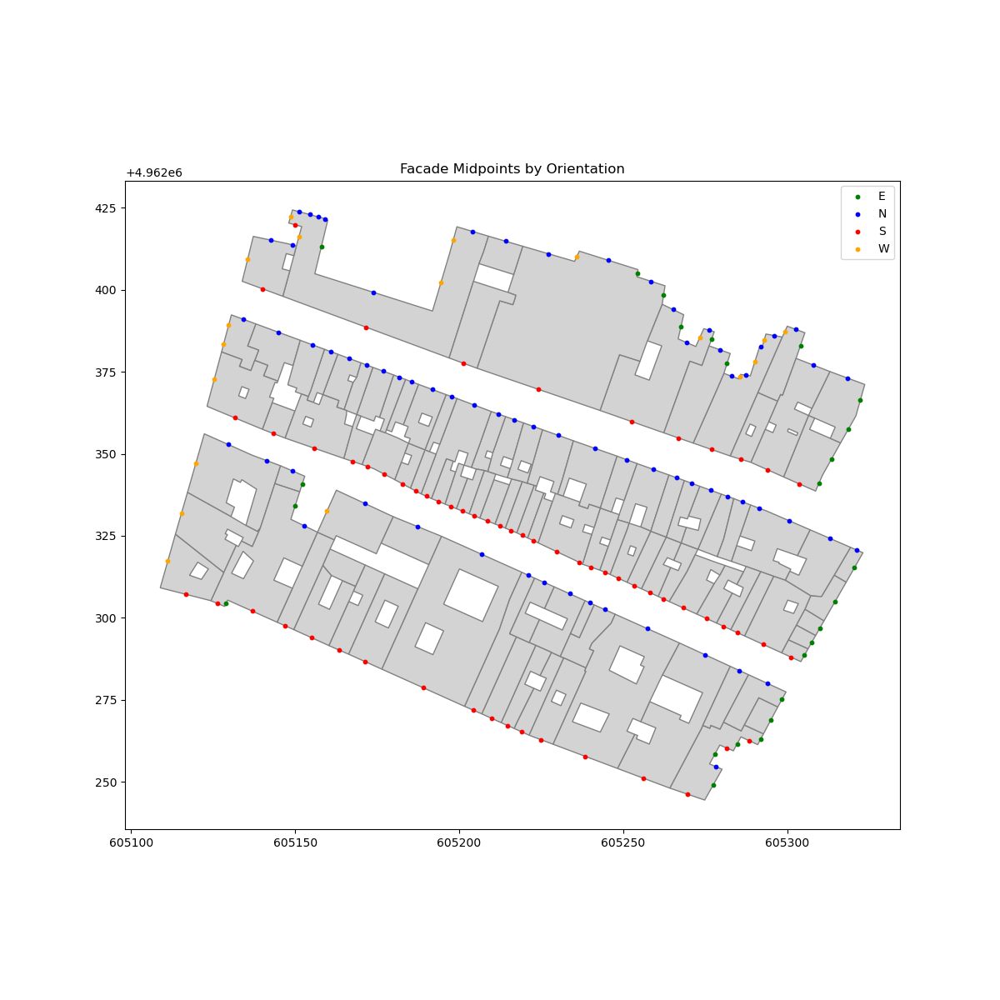

In [18]:
# Plot midpoints grouped by orientation
fig, ax = plt.subplots(figsize=(12, 12))
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')

# Plot midpoints by orientation, using different colors or markers for each orientation
colors = {'N': 'blue', 'NE': 'cyan', 'E': 'green', 'SE': 'yellow', 'S': 'orange', 'SW': 'red', 'W': 'purple', 'NW': 'pink'}
colors = {'N': 'blue', 'E': 'green', 'S': 'red', 'W': 'orange'}
for orientation, group in oriented_facade_segments_gdf.groupby('orientation'):
    group.plot(ax=ax, color=colors.get(orientation, 'black'), markersize=10, label=orientation)

plt.legend()
plt.title("Facade Midpoints by Orientation")
plt.show()

In [19]:
# Process boundary segments to assign orientation based on exterior boundaries
def add_orientation_to_segments(exterior_boundaries_gdf):
    oriented_segments = []

    for index, row in exterior_boundaries_gdf.iterrows():
        boundary = row['geometry']  # Get the exterior boundary LINEARRING
        group_id = row['group_id']

        # Iterate over each segment of the exterior boundary
        exterior_coords = list(boundary.coords)
        for i in range(len(exterior_coords) - 1):
            p1 = exterior_coords[i]
            p2 = exterior_coords[i + 1]
            segment = LineString([p1, p2])

            # Calculate the azimuth and orientation for the segment
            azimuth = calculate_azimuth(p1, p2)
            orientation = classify_orientation(azimuth)

            # Add the orientation to the boundary segment data
            oriented_segments.append({
                'group_id': group_id,
                'geometry': segment,
                'orientation': orientation
            })

    # Create a new GeoDataFrame with oriented segments
    oriented_segments_gdf = gpd.GeoDataFrame(oriented_segments, geometry='geometry', crs=exterior_boundaries_gdf.crs)
    
    return oriented_segments_gdf

# Apply the function to classify and add orientation to boundary segments
oriented_segments_gdf = add_orientation_to_segments(exterior_boundaries_gdf)

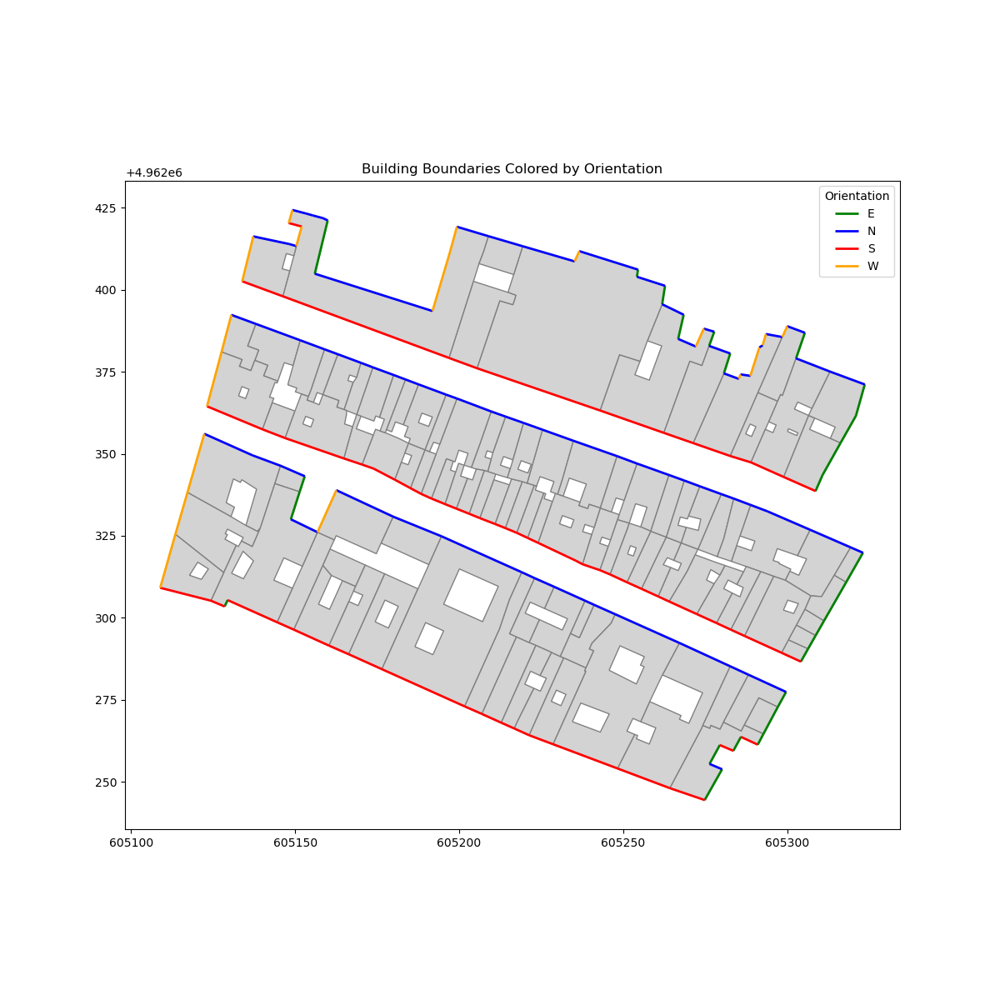

In [20]:
# Plot the segments, coloring by orientation
fig, ax = plt.subplots(figsize=(12, 12))

# Plot buildings or blocks if needed (optional, for context)
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey')

# Plot the oriented segments, color-coded by their orientation
colors = {'N': 'blue', 'E': 'green', 'S': 'red', 'W': 'orange'}
for orientation, group in oriented_segments_gdf.groupby('orientation'):
    group.plot(ax=ax, color=colors[orientation], linewidth=2, label=orientation)

# Add legend
plt.legend(title="Orientation")
plt.title("Building Boundaries Colored by Orientation")
plt.show()

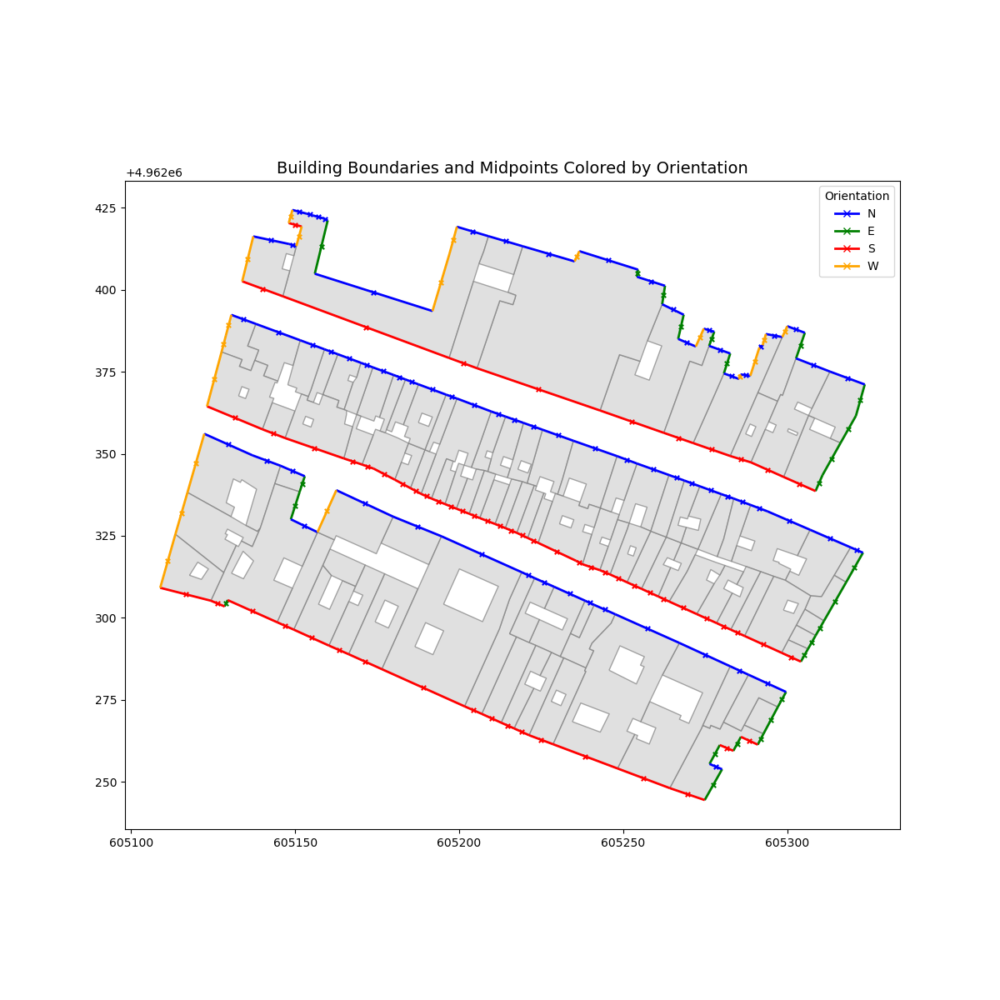

In [21]:
# Plot the segments and midpoints, coloring by orientation
fig, ax = plt.subplots(figsize=(12, 12))

# Plot buildings or blocks for context
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey', alpha=0.7)  # Slight transparency for context

# Define colors for orientations
colors = {'N': 'blue', 'E': 'green', 'S': 'red', 'W': 'orange'}

# Plot the oriented segments (building boundaries) and midpoints together
for orientation, group in oriented_segments_gdf.groupby('orientation'):
    # Plot boundary segments
    group.plot(ax=ax, color=colors[orientation], linewidth=2)
    
    # Plot midpoints with the same color but different marker
    oriented_facade_segments_gdf.groupby('orientation').get_group(orientation).plot(ax=ax, color=colors[orientation], markersize=15, marker='x')

# Add a combined legend only once for both lines and midpoints
legend_labels = [plt.Line2D([0], [0], color=colors[direction], lw=2, marker='x', label=f'{direction}')
                 for direction in colors]
ax.legend(handles=legend_labels, title="Orientation", loc='upper right')

# Improve title and axis display
plt.title("Building Boundaries and Midpoints Colored by Orientation", fontsize=14)

# Show the plot
plt.show()

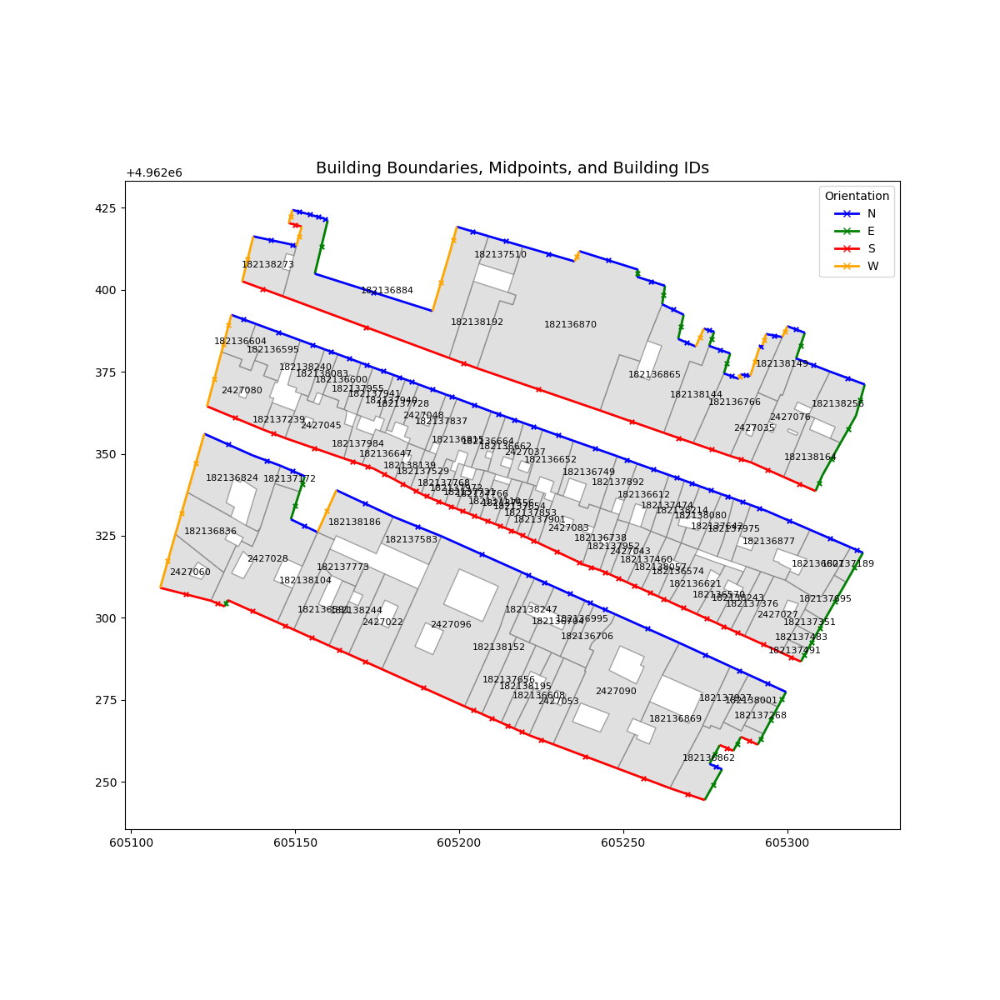

In [22]:
# Plot the segments and midpoints, coloring by orientation
fig, ax = plt.subplots(figsize=(12, 12))

# Plot buildings or blocks for context
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey', alpha=0.7)  # Slight transparency for context

# Define colors for orientations
colors = {'N': 'blue', 'E': 'green', 'S': 'red', 'W': 'orange'}

# Plot the oriented segments (building boundaries) and midpoints together
for orientation, group in oriented_segments_gdf.groupby('orientation'):
    # Plot boundary segments
    group.plot(ax=ax, color=colors[orientation], linewidth=2)
    
    # Plot midpoints with the same color but different marker
    oriented_facade_segments_gdf.groupby('orientation').get_group(orientation).plot(ax=ax, color=colors[orientation], markersize=15, marker='x')

# Add a combined legend only once for both lines and midpoints
legend_labels = [plt.Line2D([0], [0], color=colors[direction], lw=2, marker='x', label=f'{direction}')
                 for direction in colors]
ax.legend(handles=legend_labels, title="Orientation", loc='upper right')

# Plot building IDs on the building shapes using their centroids
for idx, row in gdf_projected.iterrows():  # Assuming gdf_projected has the building geometries
    # Calculate the centroid of the building geometry
    building_centroid = row['geometry'].centroid
    building_id = row['osm_id']  # Assuming the building ID is in 'osm_id'
    
    # Add text labels at the centroid of the building
    ax.text(building_centroid.x, building_centroid.y, str(building_id), fontsize=8, ha='center', va='center', color='black')

# Improve title and axis display
plt.title("Building Boundaries, Midpoints, and Building IDs", fontsize=14)

# Show the plot
plt.show()


In [24]:
from tqdm import tqdm
from shapely.ops import nearest_points

# Ensure that building_id in oriented_facade_segments_gdf matches the index type of gdf_projected
oriented_facade_segments_gdf['building_id'] = oriented_facade_segments_gdf['building_id'].astype(gdf_projected.index.dtype)

# Initialize an empty list to store the final results
matched_rows = []

# Iterate over each unique group_id and track progress using tqdm
for group in tqdm(oriented_facade_segments_gdf['group_id'].unique(), desc="Processing Groups"):
    # Select all midpoints and edges for the current group
    group_midpoints = oriented_facade_segments_gdf[oriented_facade_segments_gdf['group_id'] == group]
    group_edges = oriented_segments_gdf[oriented_segments_gdf['group_id'] == group]
    
    # Iterate over each midpoint in the group
    for idx, midpoint_row in group_midpoints.iterrows():
        midpoint = midpoint_row['geometry']  # Get the midpoint geometry
        
        # Find the closest edge to this midpoint
        closest_edge = None
        min_distance = float('inf')
        for _, edge_row in group_edges.iterrows():
            edge = edge_row['geometry']  # Get the edge geometry
            # Calculate the distance between the midpoint and the edge
            distance = midpoint.distance(edge)
            if distance < min_distance:
                min_distance = distance
                closest_edge = edge_row

        # Get the building details from gdf_projected using building_id
        building_id = midpoint_row['building_id']
        building_info = gdf_projected.loc[building_id]  # Now building_id should match the type of gdf_projected's index

        # Add the matched row (midpoint + closest edge + osm_id) to the result
        matched_rows.append({
            'group_id': group,
            'building_id': building_id,
            'osm_id': building_info['osm_id'],  # Get osm_id from gdf_projected
            'geometry_midpoint': midpoint,
            'orientation_midpoint': midpoint_row['orientation'],
            'geometry_outer_edge': closest_edge['geometry'],
            'orientation_outer_edge': closest_edge['orientation']
        })


Processing Groups: 100%|██████████| 3/3 [00:00<00:00,  4.01it/s]


In [25]:
# Create the first GeoDataFrame with geometry_midpoint as the active geometry
gdf_midpoint  = gpd.GeoDataFrame(matched_rows, geometry='geometry_midpoint', crs=oriented_facade_segments_gdf.crs)
# Create the second GeoDataFrame with geometry_outer_edge as the active geometry
gdf_outer_edge  = gpd.GeoDataFrame(matched_rows, geometry='geometry_outer_edge', crs=oriented_facade_segments_gdf.crs)

In [26]:
# keep only S and north orientation
gdf_midpoint = gdf_midpoint[gdf_midpoint['orientation_midpoint'].isin(['S', 'N'])]

In [27]:
gdf_midpoint

,group_id,building_id,osm_id,geometry_midpoint,orientation_midpoint,geometry_outer_edge,orientation_outer_edge
0,block_0,34,182136815,POINT (605189.957 4962337.062),S,LINESTRING (605191.5512054511 4962336.34351437...,S
1,block_0,76,182137529,POINT (605186.74 4962338.654),S,LINESTRING (605188.3636461565 4962337.78027592...,S
2,block_0,123,182138139,POINT (605182.741 4962340.811),S,LINESTRING (605185.1156428983 4962339.52716788...,S
3,block_0,12,182136647,POINT (605177.148 4962343.78),S,LINESTRING (605180.3671241255 4962342.09397253...,S
4,block_0,12,182136647,POINT (605172.146 4962346.093),S,LINESTRING (605173.9284834105 4962345.46647953...,S
...,...,...,...,...,...,...,...
167,block_2,127,182138164,POINT (605303.719 4962340.791),S,LINESTRING (605308.5914034995 4962338.63759303...,S
168,block_2,178,2427076,POINT (605293.875 4962345.163),S,LINESTRING (605298.8467651804 4962342.94473017...,S
169,block_2,164,2427035,POINT (605285.746 4962348.352),S,LINESTRING (605288.9022570765 4962347.38194431...,S
170,block_2,30,182136766,POINT (605276.937 4962351.292),S,LINESTRING (605282.589834345 4962349.323046219...,S


In [28]:
import cv2
import numpy as np
import math
import geopandas as gpd
import matplotlib.pyplot as plt

In [29]:
# Find the relevant pictures
gdf = gpd.read_file('../data/DEMO_TRACCIATO/RUN.shp')

# Define the values to filter for in the 'RUN' column
run_values = ['116', '117']

# Filter the GeoDataFrame where the 'RUN' column matches any of the values in run_values
gdf_subset = gdf[gdf['RUN'].isin(run_values)]

In [30]:
gdf_subset

,X,Y,Z,RUN,FOTO,PATH,FRAME,COMUNE,Heading,FRAME_PAD,ANNO,Roll,Pitch,DATA,STRUMENTO,geometry
2515,605331.747,4962326.188,91.764,116,pano_000116_000000.jpg,B,0,PARMA,45.95000,0000,2023,2.13376,-0.76102,2023-11-13,MX50,POINT (605331.747 4962326.188)
2516,605331.616,4962326.066,91.762,116,pano_000116_000001.jpg,B,1,PARMA,48.40613,0001,2023,2.38716,-0.87668,2023-11-13,MX50,POINT (605331.616 4962326.066)
2517,605328.086,4962325.264,91.799,116,pano_000116_000002.jpg,B,2,PARMA,96.72445,0002,2023,1.29739,-2.42945,2023-11-13,MX50,POINT (605328.086 4962325.264)
2518,605324.937,4962326.273,91.848,116,pano_000116_000003.jpg,B,3,PARMA,113.00508,0003,2023,0.23316,-1.15743,2023-11-13,MX50,POINT (605324.937 4962326.273)
2519,605322.138,4962327.588,91.850,116,pano_000116_000004.jpg,B,4,PARMA,115.87231,0004,2023,0.21012,-0.83360,2023-11-13,MX50,POINT (605322.138 4962327.588)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2647,605136.254,4962355.894,92.753,117,pano_000117_000061.jpg,B,61,PARMA,111.87610,0061,2023,0.47016,-1.45724,2023-11-13,MX50,POINT (605136.254 4962355.894)
2648,605133.434,4962357.041,92.810,117,pano_000117_000062.jpg,B,62,PARMA,112.23465,0062,2023,0.09388,-1.36522,2023-11-13,MX50,POINT (605133.434 4962357.041)
2649,605130.624,4962358.199,92.861,117,pano_000117_000063.jpg,B,63,PARMA,112.74831,0063,2023,0.12817,-1.54673,2023-11-13,MX50,POINT (605130.624 4962358.199)
2650,605127.830,4962359.382,92.924,117,pano_000117_000064.jpg,B,64,PARMA,113.50688,0064,2023,0.23950,-1.12233,2023-11-13,MX50,POINT (605127.83 4962359.382)


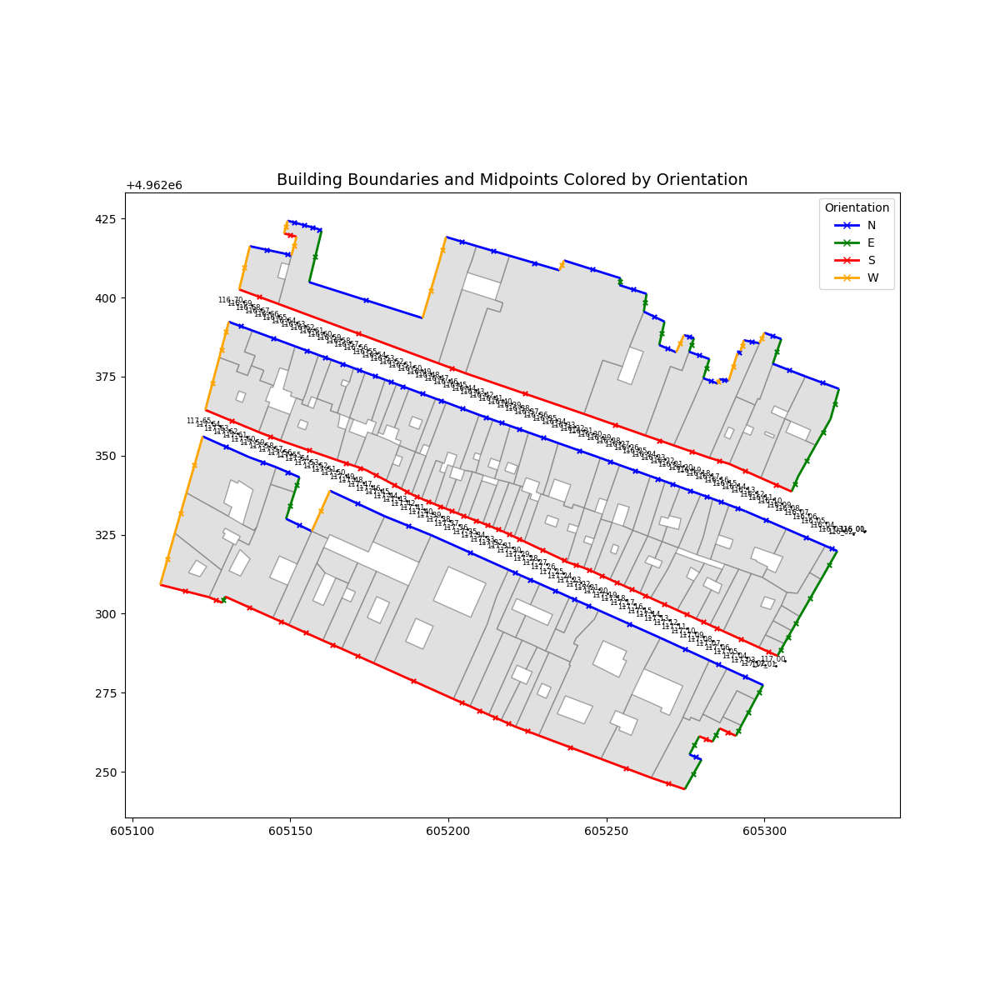

In [31]:
# Plot the segments and midpoints, coloring by orientation
fig, ax = plt.subplots(figsize=(12, 12))

# Plot buildings or blocks for context
gdf_projected.plot(ax=ax, color='lightgrey', edgecolor='grey', alpha=0.7)  # Slight transparency for context

# Define colors for orientations
colors = {'N': 'blue', 'E': 'green', 'S': 'red', 'W': 'orange'}

# Plot the oriented segments (building boundaries) and midpoints together
for orientation, group in oriented_segments_gdf.groupby('orientation'):
    # Plot boundary segments
    group.plot(ax=ax, color=colors[orientation], linewidth=2)
    
    # Plot midpoints with the same color but different marker
    oriented_facade_segments_gdf.groupby('orientation').get_group(orientation).plot(ax=ax, color=colors[orientation], markersize=15, marker='x')

# Add a combined legend only once for both lines and midpoints
legend_labels = [plt.Line2D([0], [0], color=colors[direction], lw=2, marker='x', label=f'{direction}')
                 for direction in colors]
ax.legend(handles=legend_labels, title="Orientation", loc='upper right')

# Plot the subset points and their labels
gdf_subset.plot(ax=ax, color='black', markersize=1)

# Add text labels for points in gdf_subset
for x, y, label in zip(gdf_subset.geometry.x, gdf_subset.geometry.y, gdf_subset['FOTO']):  # Assuming 'name' is the column you want to plot
    ax.text(x, y, label[8:11] + '_' + label[16:18], fontsize=6, ha='right', color='black')

# Improve title and axis display
plt.title("Building Boundaries and Midpoints Colored by Orientation", fontsize=14)

# Show the plot
plt.show()


In [32]:
# Create an empty list to store the results
combined_rows = []

# Iterate over each point in gdf_midpoint
for i, row in gdf_midpoint.iterrows():
    # Get the geometry (point) from gdf_midpoint
    point_gdf_midpoint = row['geometry_midpoint']

    # Calculate the distance from this point to every point in gdf_subset
    distances = gdf_subset.geometry.distance(point_gdf_midpoint)

    # Find the index of the minimum distance (closest point)
    min_distance_index = distances.idxmin()
    min_distance_value = distances.min()

    # Get the closest row from gdf_subset
    closest_row = gdf_subset.loc[min_distance_index]

    # Combine the row from gdf_midpoint and the closest row from gdf_subset
    combined_row = pd.concat([row, closest_row], axis=0)

    # Append the combined row to the results list
    combined_rows.append(combined_row)

# Convert the list of combined rows into a new GeoDataFrame
gdf_combined = pd.DataFrame(combined_rows)

# Convert to GeoDataFrame if needed
gdf_combined = gpd.GeoDataFrame(gdf_combined, geometry='geometry_midpoint', crs=gdf_midpoint.crs)

In [33]:
gdf_combined

,group_id,building_id,osm_id,geometry_midpoint,orientation_midpoint,geometry_outer_edge,orientation_outer_edge,X,Y,Z,...,FRAME,COMUNE,Heading,FRAME_PAD,ANNO,Roll,Pitch,DATA,STRUMENTO,geometry
0,block_0,34,182136815,POINT (605189.957 4962337.062),S,LINESTRING (605191.5512054511 4962336.34351437...,S,605189.620,4962334.346,92.131,...,42,PARMA,114.49361,0042,2023,-1.71528,-0.90587,2023-11-13,MX50,POINT (605189.62 4962334.346)
1,block_0,76,182137529,POINT (605186.74 4962338.654),S,LINESTRING (605188.3636461565 4962337.78027592...,S,605186.902,4962335.581,92.151,...,43,PARMA,114.05420,0043,2023,-2.39535,-1.28827,2023-11-13,MX50,POINT (605186.902 4962335.581)
2,block_0,123,182138139,POINT (605182.741 4962340.811),S,LINESTRING (605185.1156428983 4962339.52716788...,S,605181.355,4962337.983,92.199,...,45,PARMA,113.76738,0045,2023,-1.87929,-1.36511,2023-11-13,MX50,POINT (605181.355 4962337.983)
3,block_0,12,182136647,POINT (605177.148 4962343.78),S,LINESTRING (605180.3671241255 4962342.09397253...,S,605175.786,4962340.422,92.243,...,47,PARMA,113.94741,0047,2023,-1.74483,-1.01618,2023-11-13,MX50,POINT (605175.786 4962340.422)
4,block_0,12,182136647,POINT (605172.146 4962346.093),S,LINESTRING (605173.9284834105 4962345.46647953...,S,605170.233,4962342.838,92.293,...,49,PARMA,113.16203,0049,2023,-1.86882,-0.75568,2023-11-13,MX50,POINT (605170.233 4962342.838)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,block_2,127,182138164,POINT (605303.719 4962340.791),S,LINESTRING (605308.5914034995 4962338.63759303...,S,605302.787,4962336.195,91.951,...,11,PARMA,112.48685,0011,2023,0.29214,-0.87520,2023-11-13,MX50,POINT (605302.787 4962336.195)
125,block_2,178,2427076,POINT (605293.875 4962345.163),S,LINESTRING (605298.8467651804 4962342.94473017...,S,605291.460,4962340.675,92.018,...,15,PARMA,110.74160,0015,2023,0.80314,-0.56635,2023-11-13,MX50,POINT (605291.46 4962340.675)
126,block_2,164,2427035,POINT (605285.746 4962348.352),S,LINESTRING (605288.9022570765 4962347.38194431...,S,605283.002,4962343.781,92.065,...,18,PARMA,109.77423,0018,2023,0.02107,-0.87105,2023-11-13,MX50,POINT (605283.002 4962343.781)
127,block_2,30,182136766,POINT (605276.937 4962351.292),S,LINESTRING (605282.589834345 4962349.323046219...,S,605274.308,4962346.763,92.088,...,21,PARMA,109.51529,0021,2023,0.75497,-0.68173,2023-11-13,MX50,POINT (605274.308 4962346.763)


In [34]:
# Extract coordinates of geometry_midpoint as separate columns
gdf_combined['midpoint_x'] = gdf_combined['geometry_midpoint'].apply(lambda point: point.x)
gdf_combined['midpoint_y'] = gdf_combined['geometry_midpoint'].apply(lambda point: point.y)

# Save to GeoJSON
gdf_combined.to_file("../data/Street_view/Preprocessed_to_use_for_picture_extraction.geojson", driver="GeoJSON")

In [37]:
def calculate_yaw_pitch(camera_coords, target_coords):
    x1, y1, z1 = camera_coords
    x2, y2, z2 = target_coords

    dx = x2 - x1
    dy = y2 - y1
    dz = z2 - z1
    
    horizontal_distance = np.sqrt(dx**2 + dy**2)
    
    if horizontal_distance < 1e-6:  # Adjust this threshold as needed
        print("Warning: Camera and target are very close or directly above/below each other.")
        return 0, 90 if dz >= 0 else -90

    yaw = np.arctan2(-dy, -dx)
    yaw_deg = np.degrees(yaw)
    yaw_deg = (yaw_deg + 360) % 360
    
    pitch = np.arctan2(dz, horizontal_distance)
    pitch_deg = np.degrees(pitch)
    
    return yaw_deg, pitch_deg


def enhanced_equirectangular_to_perspective(img, fov, theta, phi, roll, height, width, output_scale=2):
    fov, theta, phi, roll = map(np.radians, (fov, theta, phi, roll))
    
    h, w = img.shape[:2]
    
    # Increase output size
    height *= output_scale
    width *= output_scale
    
    f = width / (2 * np.tan(fov / 2))
    
    Rx = np.array([[1, 0, 0], [0, np.cos(phi), -np.sin(phi)], [0, np.sin(phi), np.cos(phi)]])
    Ry = np.array([[np.cos(theta), 0, np.sin(theta)], [0, 1, 0], [-np.sin(theta), 0, np.cos(theta)]])
    Rz = np.array([[np.cos(roll), -np.sin(roll), 0], [np.sin(roll), np.cos(roll), 0], [0, 0, 1]])
    
    R = Rz @ Ry @ Rx
    
    y, x = np.indices((height, width))
    x = (x - width / 2) / f
    y = (y - height / 2) / f
    
    directions = np.dstack([x, y, np.ones_like(x)])
    directions /= np.linalg.norm(directions, axis=2, keepdims=True)
    
    directions = directions @ R.T
    
    theta_p = np.arctan2(directions[:,:,0], directions[:,:,2])
    phi_p = np.arcsin(np.clip(directions[:,:,1], -1, 1))
    
    u = (theta_p / (2 * np.pi) + 0.5) * w
    v = (phi_p / np.pi + 0.5) * h
    
    u = np.clip(u, 0, w - 1)
    v = np.clip(v, 0, h - 1)
    
    u_floor, v_floor = np.floor(u).astype(int), np.floor(v).astype(int)
    u_ceil, v_ceil = np.minimum(u_floor + 1, w - 1), np.minimum(v_floor + 1, h - 1)
    
    wu, wv = u - u_floor, v - v_floor
    
    top_left = img[v_floor, u_floor]
    top_right = img[v_floor, u_ceil]
    bottom_left = img[v_ceil, u_floor]
    bottom_right = img[v_ceil, u_ceil]
    
    output = (1 - wu[:,:,np.newaxis]) * ((1 - wv[:,:,np.newaxis]) * top_left + wv[:,:,np.newaxis] * bottom_left) + \
              wu[:,:,np.newaxis] * ((1 - wv[:,:,np.newaxis]) * top_right + wv[:,:,np.newaxis] * bottom_right)
    
    return output.astype(np.uint8)

def convert_bgr_to_rgb(image):
    # Converts the image from OpenCV's BGR format to RGB for correct color representation
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

def calculate_dynamic_fov(v1, v2):
    """
    Calculate the dynamic Field of View based on the vectors v1 and v2.
    
    Parameters:
    v1, v2: numpy arrays representing the vectors
    
    Returns:
    fov: The calculated Field of View in degrees, capped at 120°
    """
    # Ensure v1 and v2 are numpy arrays
    v1 = np.array(v1)
    v2 = np.array(v2)
    
    # Calculate the dot product of v1 and v2
    dot_product = np.dot(v1, v2)
    
    # Calculate the magnitudes of v1 and v2
    magnitude_product = np.linalg.norm(v1) * np.linalg.norm(v2)
    
    # Calculate the FoV using the arccos function
    fov_radians = np.arccos(dot_product / magnitude_product)
    
    # Convert to degrees
    fov_degrees = np.degrees(fov_radians)
    
    # Cap the FoV at 120°
    fov = min(fov_degrees, 120)
    
    return fov

def calculate_vectors(camera_coords, target_coords):
    """
    Calculate the vectors v1 and v2 based on camera and target coordinates.
    
    Parameters:
    camera_coords: (x, y, z) coordinates of the camera
    target_coords: (x, y, z) coordinates of the target
    
    Returns:
    v1, v2: numpy arrays representing the vectors
    """
    camera = np.array(camera_coords)
    target = np.array(target_coords)
    
    # Calculate v2 (vector from camera to target)
    v2 = target - camera
    
    # Assume v1 is the forward-facing vector of the camera
    # For simplicity, let's assume it's pointing along the x-axis
    v1 = np.array([1, 0, 0])
    
    return v1, v2

def adjust_yaw_based_on_position(camera_coords, midpoint_coords, scaling_factor=5):
    """
    Adjust yaw based on how far the camera is positioned relative to the midpoint.
    The adjustment is proportional to the horizontal distance (delta_x) between the camera and the midpoint.
    
    Parameters:
    - camera_coords: (x, y, z) of the camera
    - midpoint_coords: (x, y, z) of the midpoint
    - scaling_factor: How much yaw should be adjusted per unit of horizontal distance
    
    Returns:
    - yaw adjustment (in degrees)
    """
    x1, _, __ = camera_coords
    x2, _, __ = midpoint_coords
    
    # Calculate the difference in x (horizontal axis)
    delta_x = x2 - x1

    # Proportional yaw adjustment based on delta_x and the scaling factor
    yaw_adjustment = scaling_factor * delta_x

    print(f"Delta_x: {delta_x}, Yaw adjustment: {yaw_adjustment}")

    return yaw_adjustment

def adjust_fov_based_on_distance(camera_coords, midpoint_coords, calculated_fov):
    """
    Adjust the field of view based on the distance between the camera and the midpoint.
    Wider FoV (e.g., 110) is used when very close, and calculated FoV when farther away.
    
    Parameters:
    - camera_coords: (x, y, z) of the camera
    - midpoint_coords: (x, y, z) of the midpoint
    - calculated_fov: the dynamically calculated FoV based on angle
    
    Returns:
    - Adjusted FoV
    """
    x1, y1, _ = camera_coords
    x2, y2, _ = midpoint_coords
    
    # Calculate the Euclidean distance between the camera and the midpoint
    distance = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)

    print(f"Distance: {distance}")
    
    if 3.5 < distance < 5:  # If very close, set a wider FoV (e.g., 110 degrees)
        return 100, distance
    elif distance <3.5:
        return 110, distance
    else:
        # Use the dynamically calculated FoV if the distance is larger
        return calculated_fov, distance


Delta_x: 0.3374258038820699, Yaw adjustment: 0.3374258038820699
Distance: 2.736775955028779
110
block_0 34 182136815 POINT (605189.9574258039 4962337.061895148) S pano_000117_000042.jpg


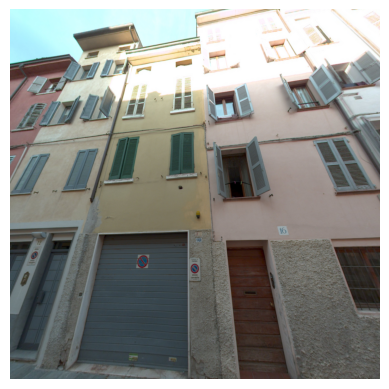

Delta_x: -0.1623554725665599, Yaw adjustment: -0.1623554725665599
Distance: 3.077008157232727
110
block_0 76 182137529 POINT (605186.7396445274 4962338.653721904) S pano_000117_000043.jpg


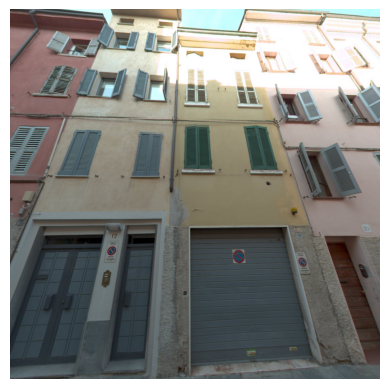

Delta_x: 1.3863835118245333, Yaw adjustment: 1.3863835118245333
Distance: 3.1491606064152977
110
block_0 123 182138139 POINT (605182.7413835118 4962340.810570208) S pano_000117_000045.jpg


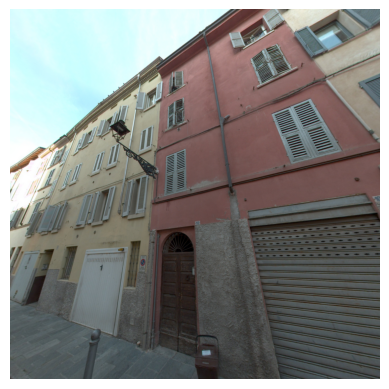

Delta_x: 1.3618037680862471, Yaw adjustment: 1.3618037680862471
Distance: 3.6238365862048925
100
block_0 12 182136647 POINT (605177.147803768 4962343.780226035) S pano_000117_000047.jpg


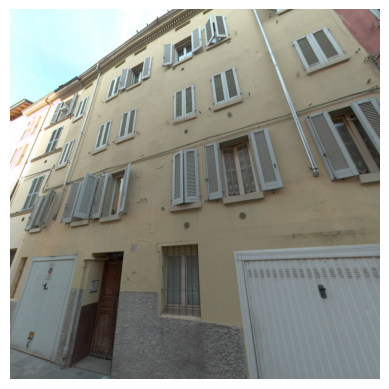

Delta_x: 1.913370199734345, Yaw adjustment: 1.913370199734345
Distance: 3.7756205469492525
100
block_0 12 182136647 POINT (605172.1463701997 4962346.092892471) S pano_000117_000049.jpg


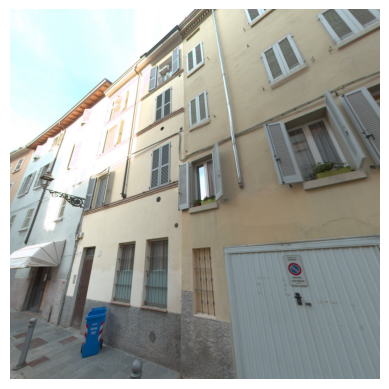

Delta_x: 0.11642152967397124, Yaw adjustment: 0.11642152967397124
Distance: 3.6694732318857435
100
block_0 116 182137984 POINT (605167.5844215297 4962347.651625912) S pano_000117_000050.jpg


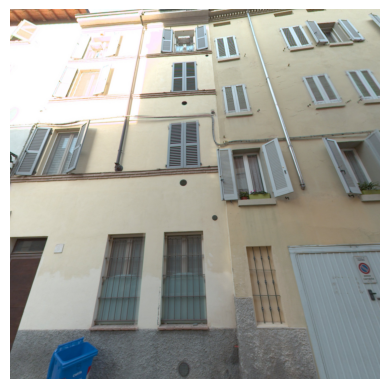

Delta_x: -0.34209651045966893, Yaw adjustment: -0.34209651045966893
Distance: 3.2194823873591414
110
block_0 167 2427045 POINT (605155.8669034896 4962351.6822555065) S pano_000117_000054.jpg


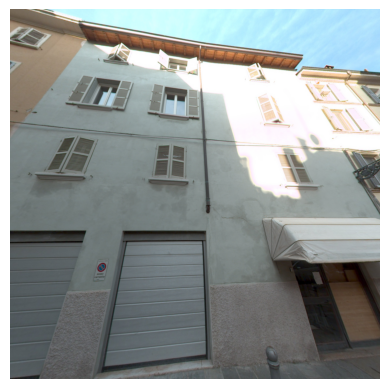

Delta_x: 1.5504482684191316, Yaw adjustment: 1.5504482684191316
Distance: 2.9161493973254466
110
block_0 64 182137239 POINT (605143.4584482685 4962356.123825394) S pano_000117_000059.jpg


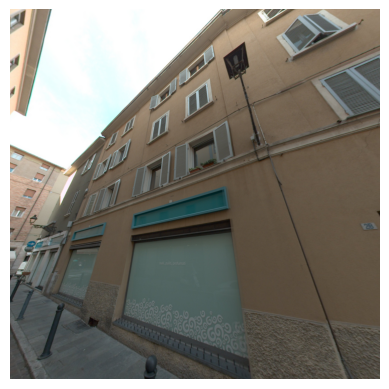

Delta_x: 0.9296334473183379, Yaw adjustment: 0.9296334473183379
Distance: 2.9209987247413816
110
block_0 180 2427080 POINT (605131.5536334473 4962360.968118127) S pano_000117_000063.jpg


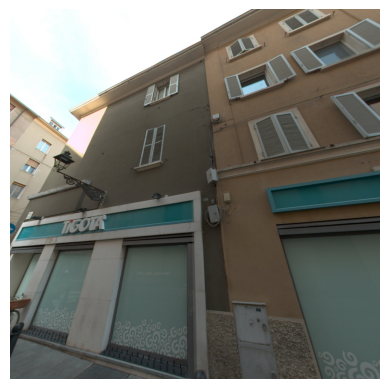

Delta_x: -3.5874040168710053, Yaw adjustment: -3.5874040168710053
Distance: 7.496849290970828
118.58888720532043
block_0 6 182136604 POINT (605134.2705959831 4962390.963198035) N pano_000116_000069.jpg


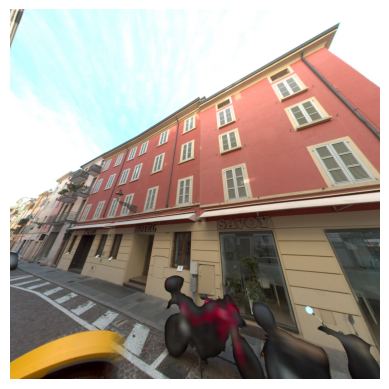

Delta_x: -1.4837414437206462, Yaw adjustment: -1.4837414437206462
Distance: 7.193270222266305
101.90373648620799
block_0 4 182136595 POINT (605144.7712585563 4962387.090417201) N pano_000116_000066.jpg


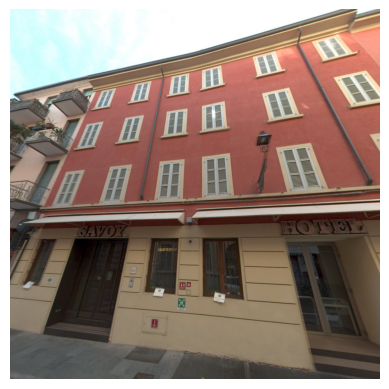

Delta_x: -2.374701385619119, Yaw adjustment: -2.374701385619119
Distance: 7.135606890710485
109.43856906449294
block_0 135 182138240 POINT (605155.2402986144 4962383.2171309255) N pano_000116_000062.jpg


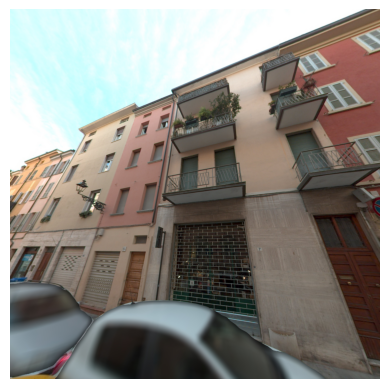

Delta_x: -2.322587960632518, Yaw adjustment: -2.322587960632518
Distance: 7.161150198697376
108.92509067565985
block_0 121 182138083 POINT (605160.9584120393 4962381.093957091) N pano_000116_000060.jpg


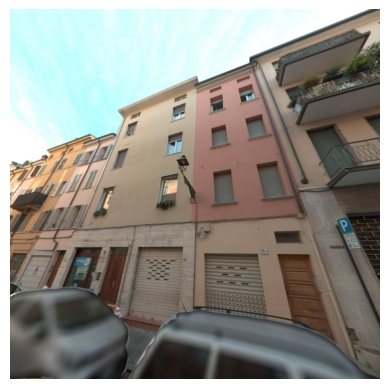

Delta_x: -2.3826741666998714, Yaw adjustment: -2.3826741666998714
Distance: 7.100352247855278
109.60727984687583
block_0 5 182136600 POINT (605166.5213258333 4962379.02936293) N pano_000116_000058.jpg


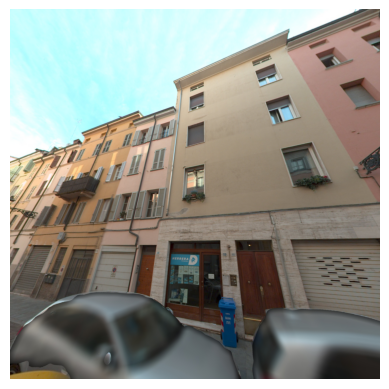

Delta_x: -2.6653169476194307, Yaw adjustment: -2.6653169476194307
Distance: 7.021658740062881
112.3079843981957
block_0 111 182137955 POINT (605171.8656830523 4962377.027864454) N pano_000116_000056.jpg


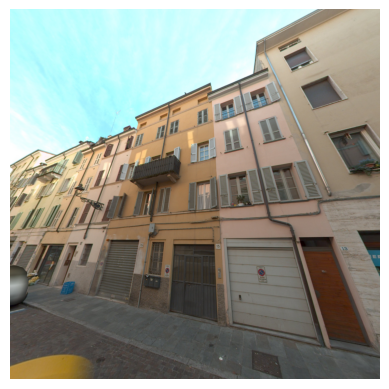

Delta_x: -3.405218734405935, Yaw adjustment: -3.405218734405935
Distance: 7.016415996589163
119.03354955117227
block_0 108 182137941 POINT (605176.8317812656 4962375.18129717) N pano_000116_000054.jpg


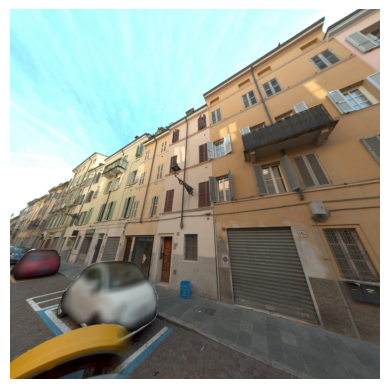

Delta_x: -1.2811643677996472, Yaw adjustment: -1.2811643677996472
Distance: 7.033863890203779
100.49456948497321
block_0 107 182137940 POINT (605181.8018356322 4962373.334797351) N pano_000116_000053.jpg


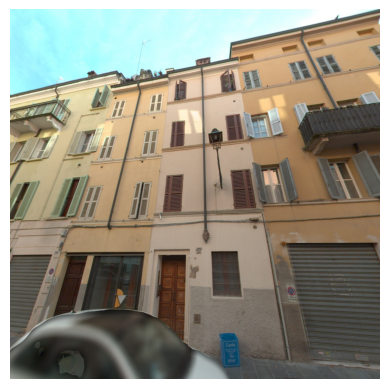

Delta_x: -3.1897131172008812, Yaw adjustment: -3.1897131172008812
Distance: 6.987383767279174
117.16123435760849
block_0 93 182137728 POINT (605185.6142868828 4962371.897146926) N pano_000116_000051.jpg


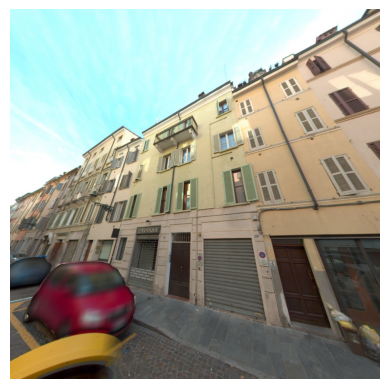

Delta_x: -2.6898265233030543, Yaw adjustment: -2.6898265233030543
Distance: 6.9208551729014545
112.8708494110525
block_0 168 2427048 POINT (605191.8021734767 4962369.587239882) N pano_000116_000049.jpg


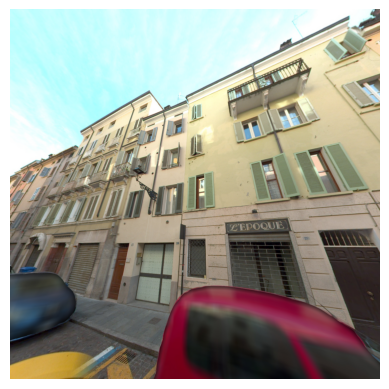

Delta_x: -2.5386155516607687, Yaw adjustment: -2.5386155516607687
Distance: 6.8573657947588
111.72812083203259
block_0 100 182137837 POINT (605197.6473844483 4962367.4328432735) N pano_000116_000047.jpg


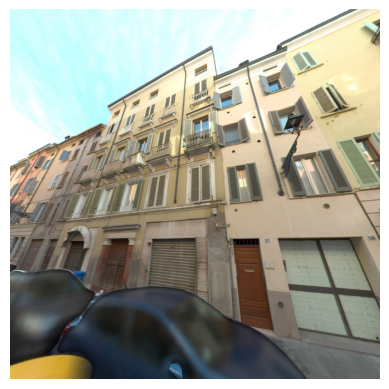

Delta_x: -1.338270738022402, Yaw adjustment: -1.338270738022402
Distance: 6.97412753878838
101.06314826806616
block_0 34 182136815 POINT (605204.519729262 4962364.867477639) N pano_000116_000045.jpg


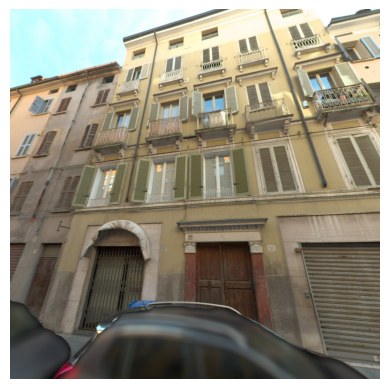

Delta_x: -2.4899071701802313, Yaw adjustment: -2.4899071701802313
Distance: 6.955543517214027
110.97585475626614
block_0 16 182136664 POINT (605211.9250928299 4962362.116390858) N pano_000116_000042.jpg


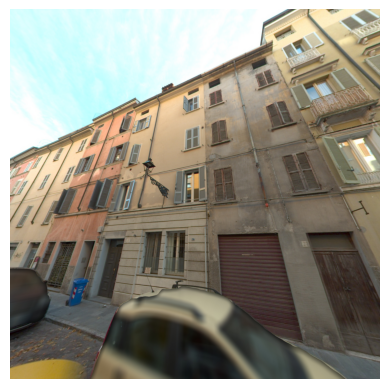

Delta_x: -3.254099677898921, Yaw adjustment: -3.254099677898921
Distance: 6.958400460954078
117.88189525340714
block_0 15 182136662 POINT (605216.8619003221 4962360.36937627) N pano_000116_000040.jpg


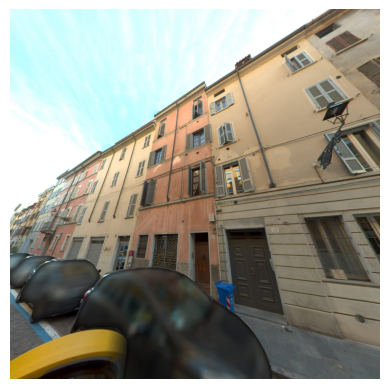

Delta_x: -3.3349763586884364, Yaw adjustment: -3.3349763586884364
Distance: 6.898214699845341
118.91129744029621
block_0 165 2427037 POINT (605222.4870236414 4962358.372515196) N pano_000116_000038.jpg


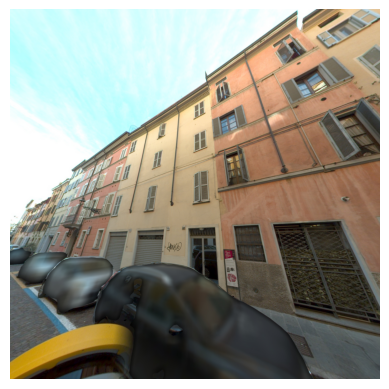

Delta_x: -1.4762579340022057, Yaw adjustment: -1.4762579340022057
Distance: 6.866247461839499
102.41565316105148
block_0 14 182136652 POINT (605230.081742066 4962355.65232951) N pano_000116_000036.jpg


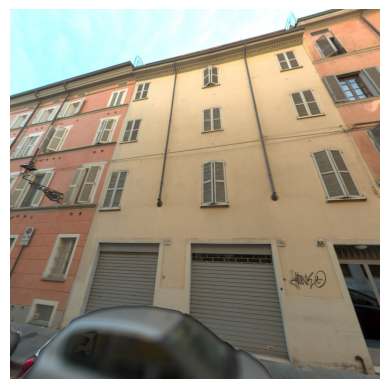

Delta_x: -1.526779142091982, Yaw adjustment: -1.526779142091982
Distance: 6.715106888495123
103.14197780300215
block_0 28 182136749 POINT (605241.4552208579 4962351.621764114) N pano_000116_000032.jpg


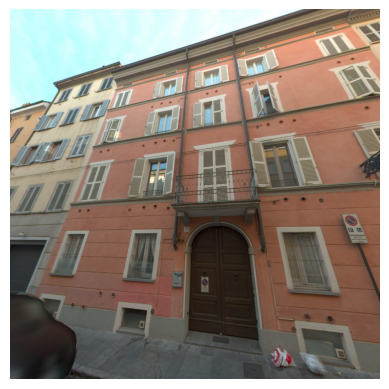

Delta_x: -3.2814227918861434, Yaw adjustment: -3.2814227918861434
Distance: 6.738452653557371
119.14160769336239
block_0 102 182137892 POINT (605251.1425772081 4962348.152508633) N pano_000116_000028.jpg


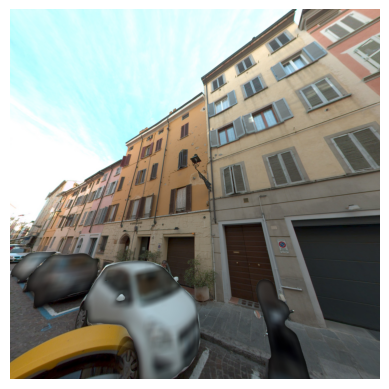

Delta_x: -1.0696760001592338, Yaw adjustment: -1.0696760001592338
Distance: 6.787418996361651
99.06743748187495
block_0 10 182136612 POINT (605259.0523239998 4962345.276399767) N pano_000116_000026.jpg


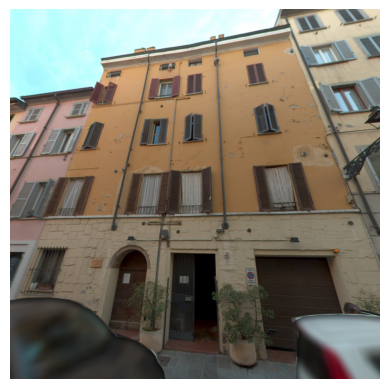

Delta_x: -2.3737861836561933, Yaw adjustment: -2.3737861836561933
Distance: 6.5871183459586335
111.12279339870574
block_0 72 182137474 POINT (605266.2732138163 4962342.683468508) N pano_000116_000023.jpg


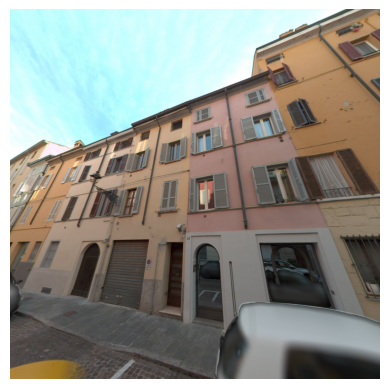

Delta_x: -3.3475958220660686, Yaw adjustment: -3.3475958220660686
Distance: 6.694371676483456
120
block_0 132 182138214 POINT (605270.9604041779 4962340.96574079) N pano_000116_000021.jpg


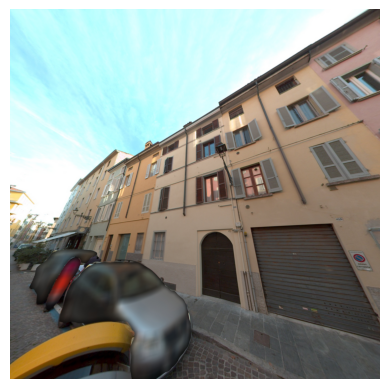

Delta_x: -3.5362996939802542, Yaw adjustment: -3.5362996939802542
Distance: 6.8587210400801855
120
block_0 120 182138080 POINT (605276.582700306 4962338.902211865) N pano_000116_000019.jpg


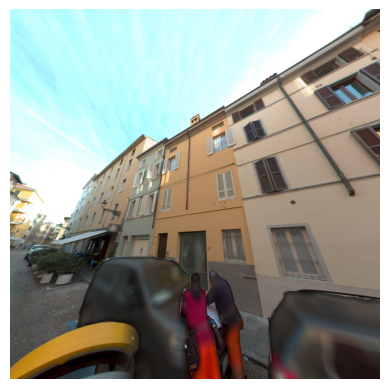

Delta_x: -1.235124705475755, Yaw adjustment: -1.235124705475755
Distance: 6.867029726129836
100.36178121636931
block_0 84 182137642 POINT (605281.7668752945 4962337.025960088) N pano_000116_000018.jpg


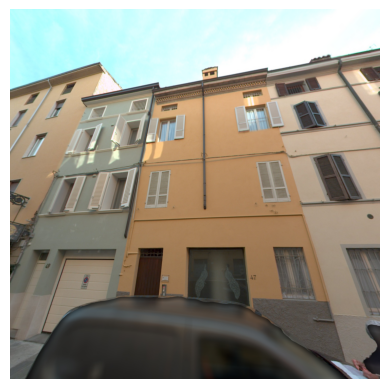

Delta_x: -2.4244874749565497, Yaw adjustment: -2.4244874749565497
Distance: 6.7939923279291285
110.90733251616055
block_0 115 182137975 POINT (605286.2355125251 4962335.371332195) N pano_000116_000016.jpg


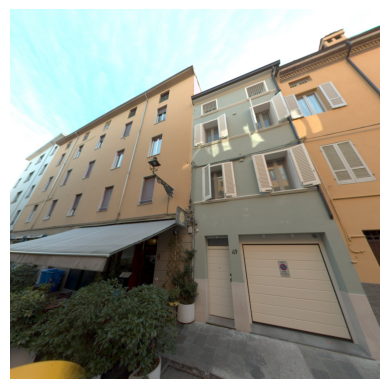

Delta_x: -2.9736155678983778, Yaw adjustment: -2.9736155678983778
Distance: 6.831151427496812
115.80452789925613
block_0 47 182136877 POINT (605291.3613844321 4962333.433021115) N pano_000116_000014.jpg


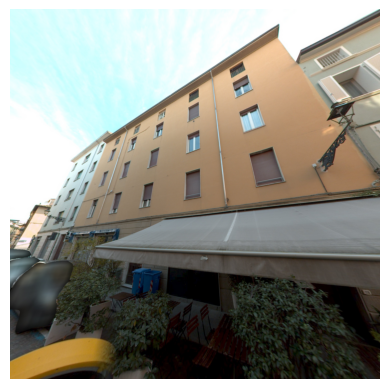

Delta_x: -2.361972637474537, Yaw adjustment: -2.361972637474537
Distance: 6.954750618675
109.85372615012041
block_0 47 182136877 POINT (605300.4250273625 4962329.653620832) N pano_000116_000011.jpg


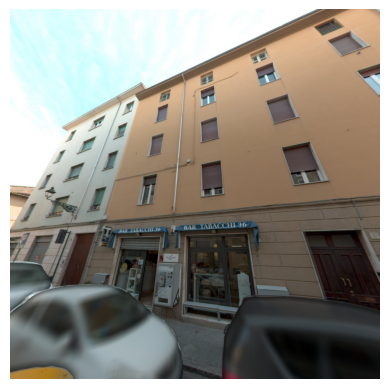

Delta_x: -3.5310086022363976, Yaw adjustment: -3.5310086022363976
Distance: 7.037213882687413
120
block_0 8 182136607 POINT (605313.1119913978 4962324.155770952) N pano_000116_000006.jpg


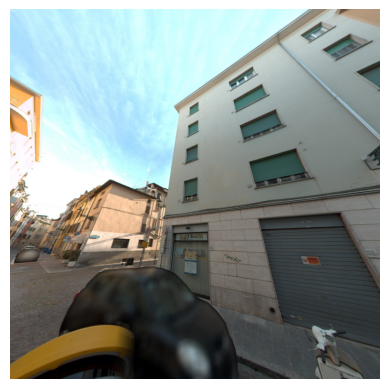

Delta_x: -3.762578443973325, Yaw adjustment: -3.762578443973325
Distance: 6.762040073109462
120
block_0 62 182137189 POINT (605321.1744215561 4962320.654442409) N pano_000116_000003.jpg


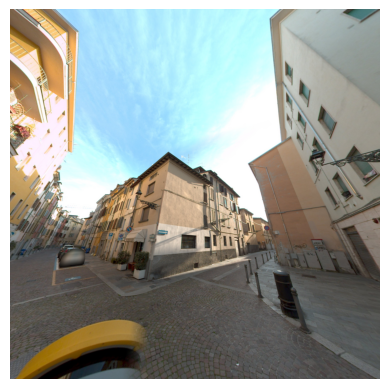

Delta_x: 0.9086041913833469, Yaw adjustment: 0.9086041913833469
Distance: 4.247614167854027
100
block_0 74 182137491 POINT (605301.1746041913 4962287.998296874) S pano_000117_000002.jpg


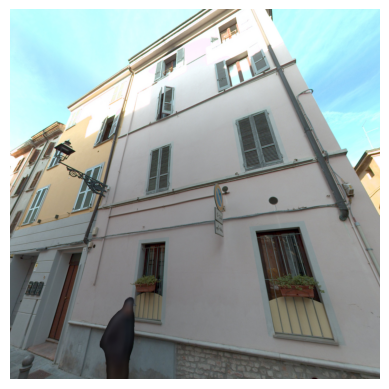

Delta_x: 0.881158982985653, Yaw adjustment: 0.881158982985653
Distance: 4.6105502999733
100
block_0 162 2427027 POINT (605292.611158983 4962291.902564376) S pano_000117_000005.jpg


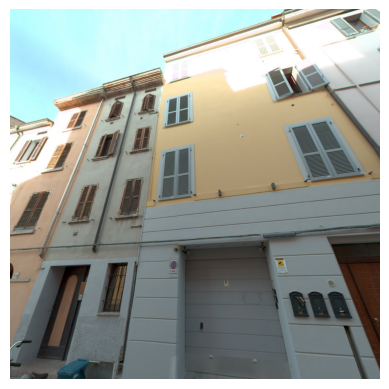

Delta_x: 1.3907103209057823, Yaw adjustment: 1.3907103209057823
Distance: 4.360002583742973
100
block_0 69 182137376 POINT (605284.8607103209 4962295.431256929) S pano_000117_000008.jpg


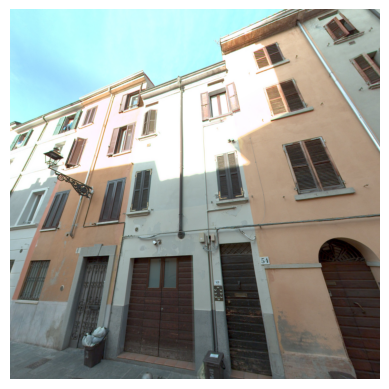

Delta_x: 2.5476998349186033, Yaw adjustment: 2.5476998349186033
Distance: 4.304112929872523
100
block_0 136 182138243 POINT (605280.580699835 4962297.40009407) S pano_000117_000010.jpg


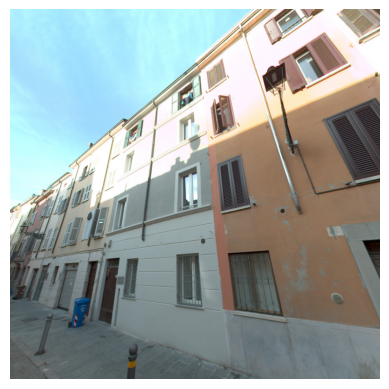

Delta_x: 2.824261464411393, Yaw adjustment: 2.824261464411393
Distance: 4.258551736645965
100
block_0 1 182136570 POINT (605275.3922614644 4962299.776288828) S pano_000117_000012.jpg


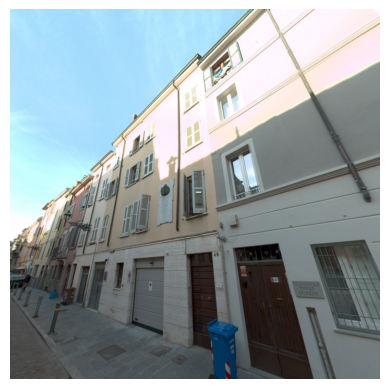

Delta_x: 1.0788577912608162, Yaw adjustment: 1.0788577912608162
Distance: 4.002336985649004
100
block_0 11 182136621 POINT (605268.1758577912 4962303.058188269) S pano_000117_000014.jpg


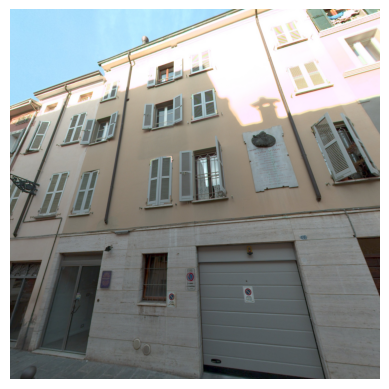

Delta_x: 0.7390605787513778, Yaw adjustment: 0.7390605787513778
Distance: 4.078912273244686
100
block_0 2 182136574 POINT (605262.3020605787 4962305.74539811) S pano_000117_000016.jpg


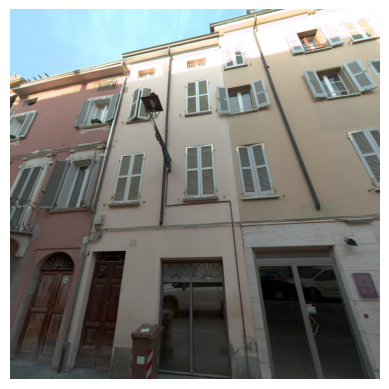

Delta_x: 2.053920418722555, Yaw adjustment: 2.053920418722555
Distance: 4.006429326137638
100
block_0 119 182138057 POINT (605258.0819204188 4962307.681896344) S pano_000117_000018.jpg


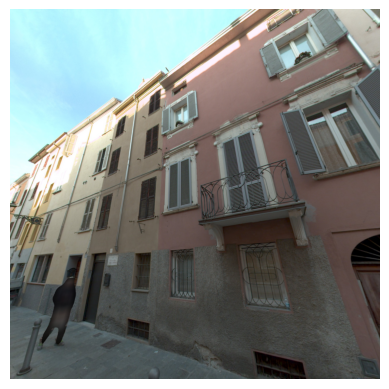

Delta_x: 2.8471693218452856, Yaw adjustment: 2.8471693218452856
Distance: 4.329412079580943
100
block_0 71 182137460 POINT (605253.3321693218 4962309.837508211) S pano_000117_000020.jpg


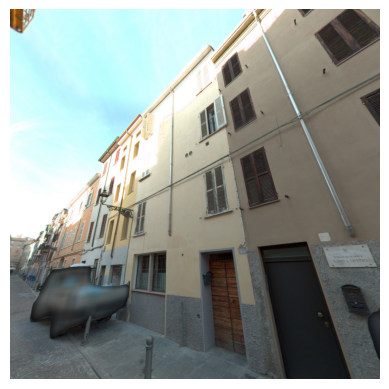

Delta_x: 0.8962439637398347, Yaw adjustment: 0.8962439637398347
Distance: 4.424651902819287
100
block_0 166 2427043 POINT (605248.5502439637 4962312.025931019) S pano_000117_000021.jpg


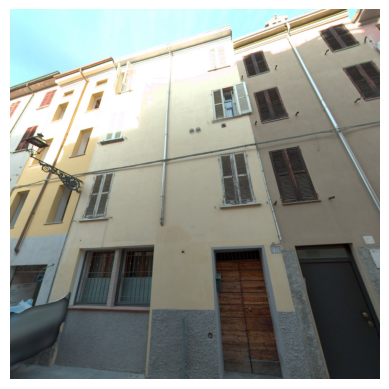

Delta_x: 2.4605539590120316, Yaw adjustment: 2.4605539590120316
Distance: 4.600817989903869
100
block_0 110 182137952 POINT (605244.426553959 4962313.869569985) S pano_000117_000023.jpg


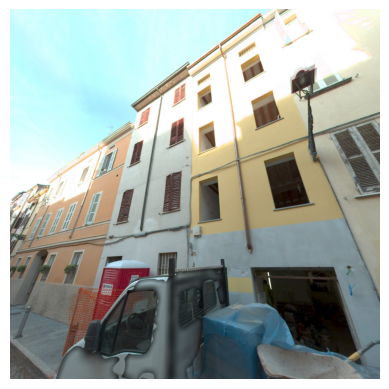

Delta_x: 1.0005629932275042, Yaw adjustment: 1.0005629932275042
Distance: 4.2454739101369965
100
block_0 26 182136738 POINT (605240.2085629932 4962315.433884441) S pano_000117_000024.jpg


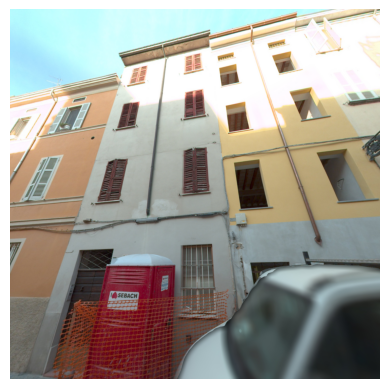

Delta_x: 2.7292719583492726, Yaw adjustment: 2.7292719583492726
Distance: 3.8174116253523667
100
block_0 182 2427083 POINT (605236.5502719583 4962316.874027181) S pano_000117_000026.jpg


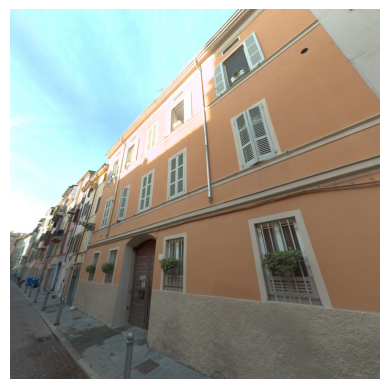

Delta_x: 1.3591200548689812, Yaw adjustment: 1.3591200548689812
Distance: 3.3763616610987954
110
block_0 182 2427083 POINT (605229.8011200549 4962320.1247298075) S pano_000117_000028.jpg


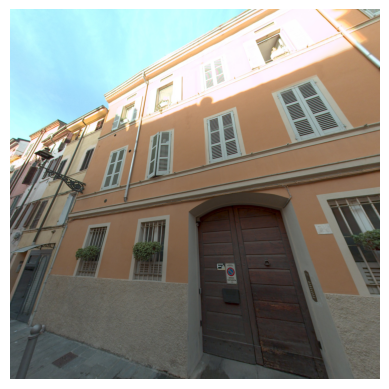

Delta_x: 2.263095326256007, Yaw adjustment: 2.263095326256007
Distance: 3.5835365519397766
100
block_0 103 182137901 POINT (605222.4590953263 4962323.593512869) S pano_000117_000031.jpg


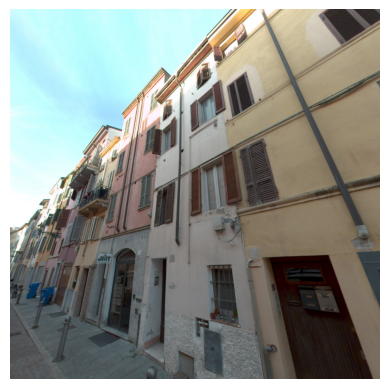

Delta_x: 1.8277128094341606, Yaw adjustment: 1.8277128094341606
Distance: 3.6156215420704694
100
block_0 101 182137853 POINT (605219.2067128094 4962325.123645015) S pano_000117_000032.jpg


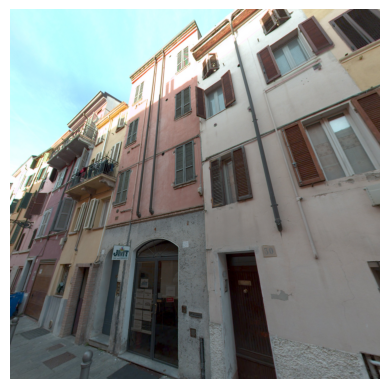

Delta_x: 1.2315800567157567, Yaw adjustment: 1.2315800567157567
Distance: 3.704216370976014
100
block_0 87 182137654 POINT (605215.8005800567 4962326.623483861) S pano_000117_000033.jpg


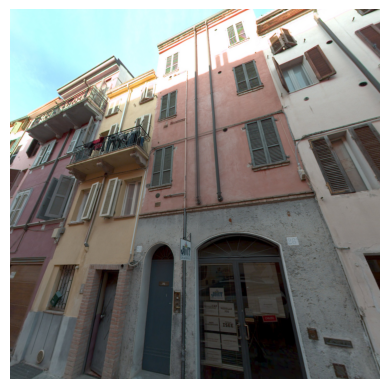

Delta_x: 0.7069364334456623, Yaw adjustment: 0.7069364334456623
Distance: 3.742667036302111
100
block_0 78 182137556 POINT (605212.4879364334 4962327.969295556) S pano_000117_000034.jpg


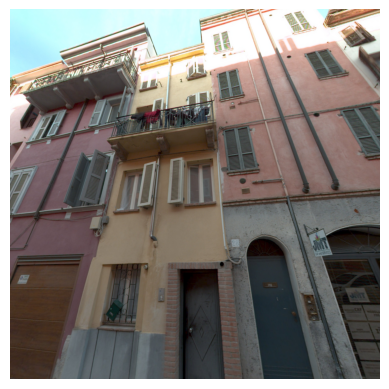

Delta_x: 2.405965826124884, Yaw adjustment: 2.405965826124884
Distance: 3.659093933225462
100
block_0 60 182137110 POINT (605208.5829658262 4962329.49986359) S pano_000117_000036.jpg


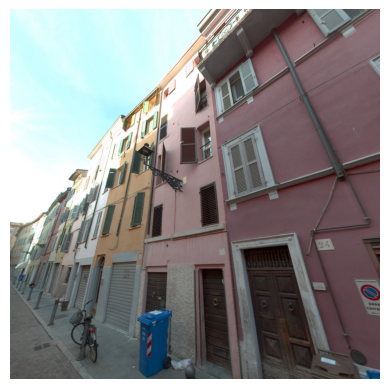

Delta_x: 1.2449102365644649, Yaw adjustment: 1.2449102365644649
Distance: 3.3134451510259897
110
block_0 95 182137766 POINT (605204.6459102365 4962331.057686775) S pano_000117_000037.jpg


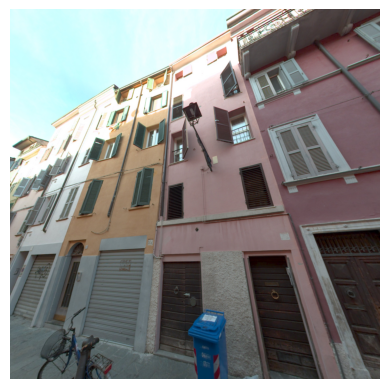

Delta_x: 0.46562394546344876, Yaw adjustment: 0.46562394546344876
Distance: 3.2474036295353987
110
block_0 90 182137721 POINT (605201.0826239454 4962332.493848888) S pano_000117_000038.jpg


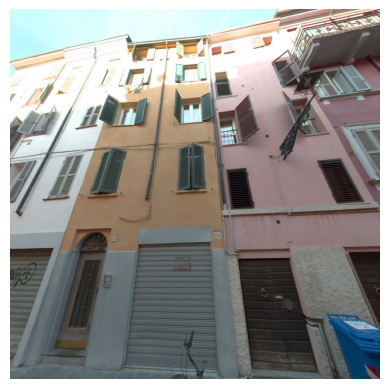

Delta_x: 2.2691287781344727, Yaw adjustment: 2.2691287781344727
Distance: 3.11144691901218
110
block_0 114 182137972 POINT (605197.3961287781 4962333.966886216) S pano_000117_000040.jpg


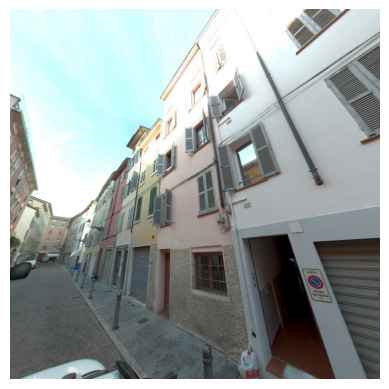

Delta_x: 1.2367396365152672, Yaw adjustment: 1.2367396365152672
Distance: 2.718123451019835
110
block_0 96 182137768 POINT (605193.6137396365 4962335.499468997) S pano_000117_000041.jpg


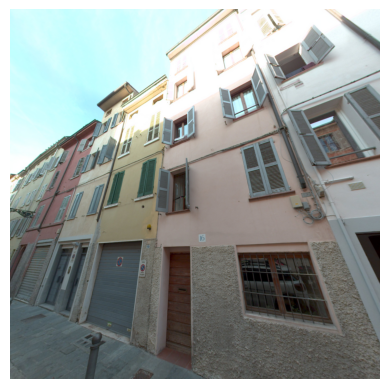

Delta_x: -19.957788045168854, Yaw adjustment: -19.957788045168854
Distance: 50.89569322532305
113.08717255916541


In [43]:
# Ensure all previous figures are closed
plt.close('all')

# Set %matplotlib inline to make sure interactive plotting is turned off
%matplotlib inline

images_folder = '../data/PANO_new/'

for i, row in gdf_combined.iterrows():
    # Coordinates for camera and target
    camera_coords = (row.loc['X'], row.loc['Y'], row.loc['Z'])  # Camera position (x, y, z)
    target_coords = (row.loc['geometry_midpoint'].x, row.loc['geometry_midpoint'].y, row.loc['Z'])  # Target position (x, y, z)
    
    # Calculate the yaw and pitch based on the coordinates
    yaw, pitch = calculate_yaw_pitch(camera_coords, target_coords)

    # adjust pitch
    pitch_adjustment = 25  # degrees
    pitch += pitch_adjustment

    # Adjust yaw based on how far the camera is from the midpoint horizontally
    yaw_adjustment = adjust_yaw_based_on_position(camera_coords, target_coords, scaling_factor=1)
    #yaw += yaw_adjustment  # Apply the yaw adjustment

    # Calculate dynamic FoV based on vectors
    v1, v2 = calculate_vectors(camera_coords, target_coords)
    calculated_fov = calculate_dynamic_fov(v1, v2)

    # Adjust FoV based on the distance between camera and midpoint
    fov, distance = adjust_fov_based_on_distance(camera_coords, target_coords, calculated_fov)
    print(fov)

    if distance > 20:
        break

    # Path to the image
    path = row.loc['PATH']
    run = row.loc['RUN']
    image_name = row.loc['FOTO']
    image_path = '{}{}/{}/{}'.format(images_folder, path, run, image_name)
    image = cv2.imread(image_path)

    # Convert the original image to RGB before any further processing
    rgb_image = convert_bgr_to_rgb(image)

    # Parameters for perspective projection
    roll = row.loc['Roll']

    output_image_shape = 'squared'  # 'squared', 'horizontal' or 'vertical'
    if output_image_shape == 'squared':
        output_width = 1024
        output_height = 1024
    elif output_image_shape == 'horizontal':
        output_width = 1024
        output_height = 512
    elif output_image_shape == 'vertical':
        output_width = 512
        output_height = 1024

    # Apply the transformation
    output_image = enhanced_equirectangular_to_perspective(rgb_image, fov, yaw, pitch, roll, output_height, output_width)

    print(row.loc['group_id'], row.loc['building_id'], row.loc['osm_id'], row.loc['geometry_midpoint'], row.loc['orientation_midpoint'], image_name)

    # Display the transformed image
    plt.imshow(output_image)
    plt.axis('off')  # Hide the axes
    plt.show()  # Show the image
    
    # Close the figure to prevent old plots from showing up again
    plt.close('all')  # Close all figures


Axis difference: -0.3374258038820699, Facade half-length: 1.748200361091712
New target: [ 605189.9574258  4962337.06189515], Midpoint: [ 605189.9574258  4962337.06189515]
Distance: 2.736775955028779
82.91780039245711 110
block_0 34 182136815 POINT (605189.9574258039 4962337.061895148) S pano_000117_000042.jpg


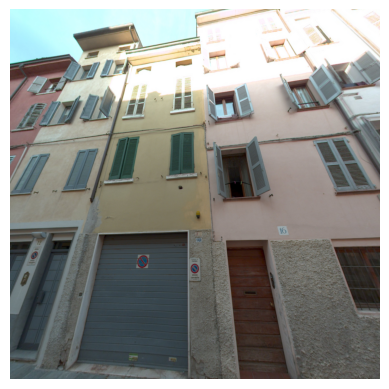

Axis difference: 0.1623554725665599, Facade half-length: 1.8439873031729301
New target: [ 605186.73964453 4962338.6537219 ], Midpoint: [ 605186.73964453 4962338.6537219 ]
Distance: 3.077008157232727
93.02456302756967 110
block_0 76 182137529 POINT (605186.7396445274 4962338.653721904) S pano_000117_000043.jpg


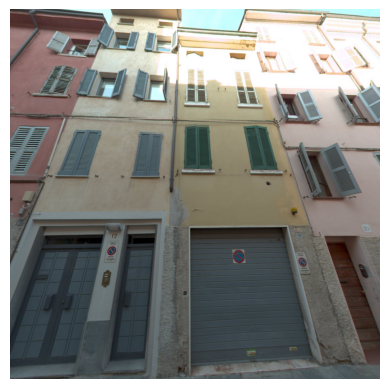

Axis difference: -1.3863835118245333, Facade half-length: 2.6989311131630207
New target: [ 605182.74138351 4962340.81057021], Midpoint: [ 605182.74138351 4962340.81057021]
Distance: 3.1491606064152977
63.88086476695311 110
block_0 123 182138139 POINT (605182.7413835118 4962340.810570208) S pano_000117_000045.jpg


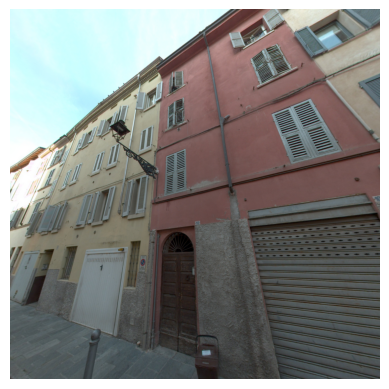

Axis difference: -1.3618037680862471, Facade half-length: 3.634208915995016
New target: [ 605177.14780377 4962343.78022604], Midpoint: [ 605177.14780377 4962343.78022604]
Distance: 3.6238365862048925
67.926814095519 100
block_0 12 182136647 POINT (605177.147803768 4962343.780226035) S pano_000117_000047.jpg


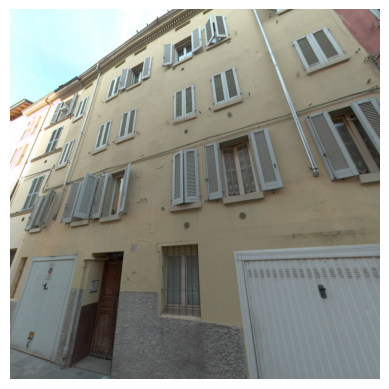

Axis difference: -1.913370199734345, Facade half-length: 1.8889999093037912
New target: [ 605171.25531359 4962346.40609894], Midpoint: [ 605172.1463702  4962346.09289247]
Distance: 3.7756205469492525
74.01220202522285 100
block_0 12 182136647 POINT (605172.1463701997 4962346.092892471) S pano_000117_000049.jpg


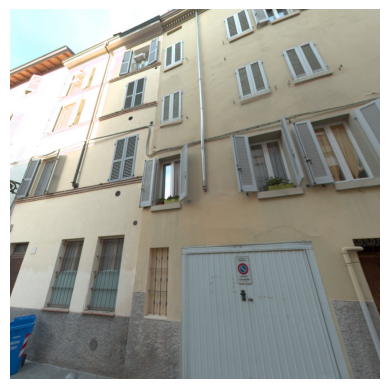

Axis difference: -0.11642152967397124, Facade half-length: 2.932014104940329
New target: [ 605167.58442153 4962347.65162591], Midpoint: [ 605167.58442153 4962347.65162591]
Distance: 3.6694732318857435
88.18186931274245 100
block_0 116 182137984 POINT (605167.5844215297 4962347.651625912) S pano_000117_000050.jpg


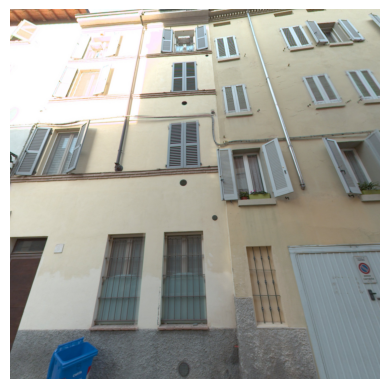

Axis difference: 0.34209651045966893, Facade half-length: 9.45947615392631
New target: [ 605155.86690349 4962351.68225551], Midpoint: [ 605155.86690349 4962351.68225551]
Distance: 3.2194823873591414
96.09966359766375 110
block_0 167 2427045 POINT (605155.8669034896 4962351.6822555065) S pano_000117_000054.jpg


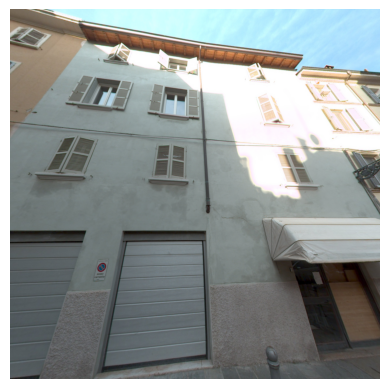

Axis difference: -1.5504482684191316, Facade half-length: 3.721641076543005
New target: [ 605143.45844827 4962356.12382539], Midpoint: [ 605143.45844827 4962356.12382539]
Distance: 2.9161493973254466
57.88119689741341 110
block_0 64 182137239 POINT (605143.4584482685 4962356.123825394) S pano_000117_000059.jpg


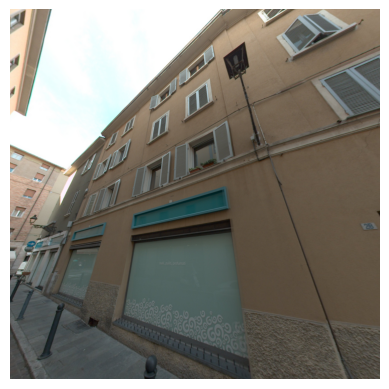

Axis difference: -0.9296334473183379, Facade half-length: 9.13182851882689
New target: [ 605131.55363345 4962360.96811813], Midpoint: [ 605131.55363345 4962360.96811813]
Distance: 2.9209987247413816
71.44234497774916 110
block_0 180 2427080 POINT (605131.5536334473 4962360.968118127) S pano_000117_000063.jpg


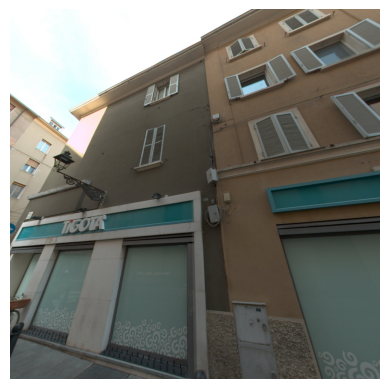

Axis difference: 3.5874040168710053, Facade half-length: 3.9654957824265504
New target: [ 605134.27059598 4962390.96319804], Midpoint: [ 605134.27059598 4962390.96319804]
Distance: 7.496849290970828
118.58888720532043 118.58888720532043
block_0 6 182136604 POINT (605134.2705959831 4962390.963198035) N pano_000116_000069.jpg


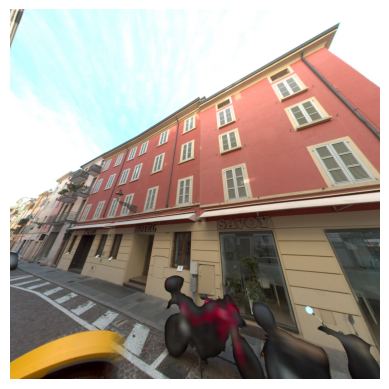

Axis difference: 1.4837414437206462, Facade half-length: 7.226570444693273
New target: [ 605144.77125856 4962387.0904172 ], Midpoint: [ 605144.77125856 4962387.0904172 ]
Distance: 7.193270222266305
101.90373648620799 101.90373648620799
block_0 4 182136595 POINT (605144.7712585563 4962387.090417201) N pano_000116_000066.jpg


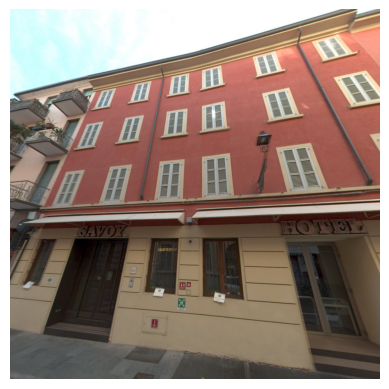

Axis difference: 2.374701385619119, Facade half-length: 3.9360192915112915
New target: [ 605155.24029861 4962383.21713093], Midpoint: [ 605155.24029861 4962383.21713093]
Distance: 7.135606890710485
109.43856906449294 109.43856906449294
block_0 135 182138240 POINT (605155.2402986144 4962383.2171309255) N pano_000116_000062.jpg


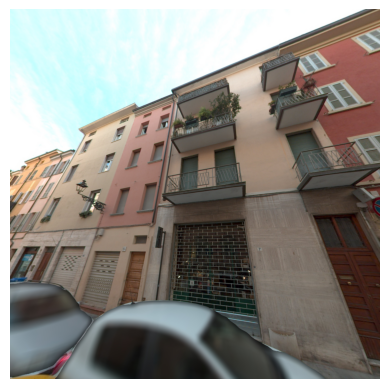

Axis difference: 2.322587960632518, Facade half-length: 2.1635488488663466
New target: [ 605159.94374265 4962381.46903301], Midpoint: [ 605160.95841204 4962381.09395709]
Distance: 7.161150198697376
117.5434210936293 117.5434210936293
block_0 121 182138083 POINT (605160.9584120393 4962381.093957091) N pano_000116_000060.jpg


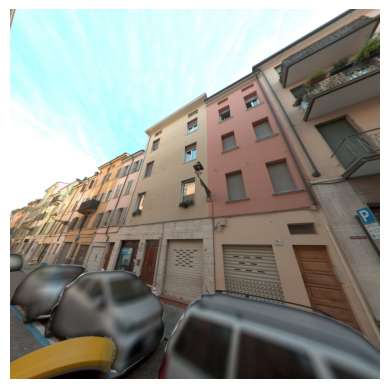

Axis difference: 2.3826741666998714, Facade half-length: 3.7701340924373814
New target: [ 605166.52132583 4962379.02936293], Midpoint: [ 605166.52132583 4962379.02936293]
Distance: 7.100352247855278
109.60727984687583 109.60727984687583
block_0 5 182136600 POINT (605166.5213258333 4962379.02936293) N pano_000116_000058.jpg


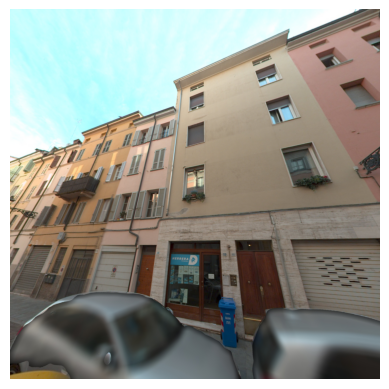

Axis difference: 2.6653169476194307, Facade half-length: 1.9367442555659464
New target: [ 605172.77107415 4962376.68433638], Midpoint: [ 605171.86568305 4962377.02786445]
Distance: 7.021658740062881
104.4298497042135 104.4298497042135
block_0 111 182137955 POINT (605171.8656830523 4962377.027864454) N pano_000116_000056.jpg


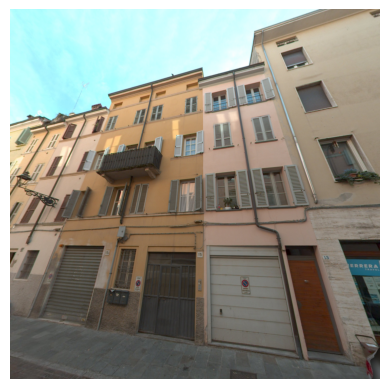

Axis difference: 3.405218734405935, Facade half-length: 3.3616194378930575
New target: [ 605178.40943928 4962374.6015416 ], Midpoint: [ 605176.83178127 4962375.18129717]
Distance: 7.016415996589163
105.22608349597441 105.22608349597441
block_0 108 182137941 POINT (605176.8317812656 4962375.18129717) N pano_000116_000054.jpg


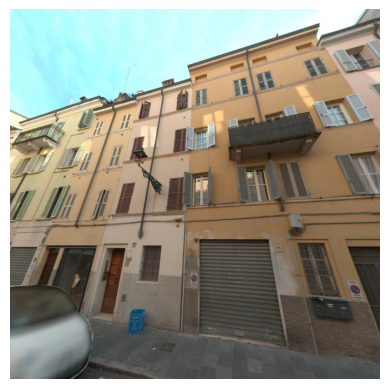

Axis difference: 1.2811643677996472, Facade half-length: 1.9404197295303445
New target: [ 605181.80183563 4962373.33479735], Midpoint: [ 605181.80183563 4962373.33479735]
Distance: 7.033863890203779
100.49456948497321 100.49456948497321
block_0 107 182137940 POINT (605181.8018356322 4962373.334797351) N pano_000116_000053.jpg


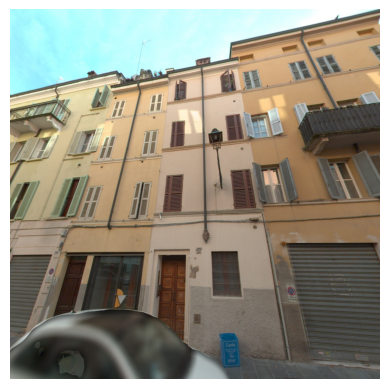

Axis difference: 3.1897131172008812, Facade half-length: 2.1340922863591154
New target: [ 605186.61314333 4962371.52181606], Midpoint: [ 605185.61428688 4962371.89714693]
Distance: 6.987383767279174
108.38379140128234 108.38379140128234
block_0 93 182137728 POINT (605185.6142868828 4962371.897146926) N pano_000116_000051.jpg


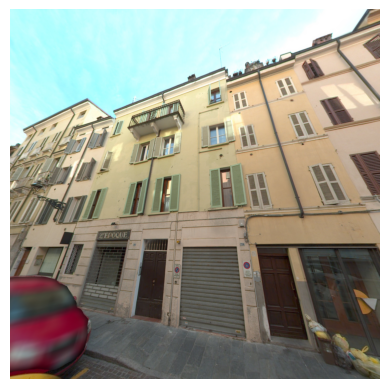

Axis difference: 2.6898265233030543, Facade half-length: 4.470883747803008
New target: [ 605191.80217348 4962369.58723988], Midpoint: [ 605191.80217348 4962369.58723988]
Distance: 6.9208551729014545
112.8708494110525 112.8708494110525
block_0 168 2427048 POINT (605191.8021734767 4962369.587239882) N pano_000116_000049.jpg


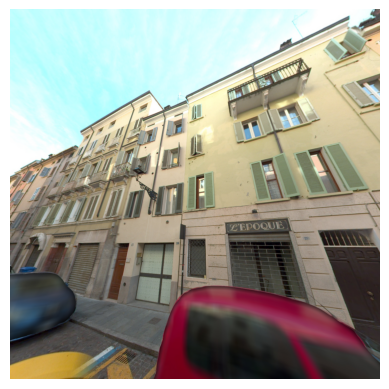

Axis difference: 2.5386155516607687, Facade half-length: 1.75879318672112
New target: [ 605198.47490309 4962367.13526762], Midpoint: [ 605197.64738445 4962367.43284327]
Distance: 6.8573657947588
104.39285896802886 104.39285896802886
block_0 100 182137837 POINT (605197.6473844483 4962367.4328432735) N pano_000116_000047.jpg


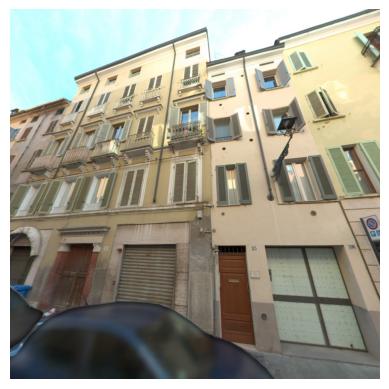

Axis difference: 1.338270738022402, Facade half-length: 5.576920512598223
New target: [ 605204.51972926 4962364.86747764], Midpoint: [ 605204.51972926 4962364.86747764]
Distance: 6.97412753878838
101.06314826806616 101.06314826806616
block_0 34 182136815 POINT (605204.519729262 4962364.867477639) N pano_000116_000045.jpg


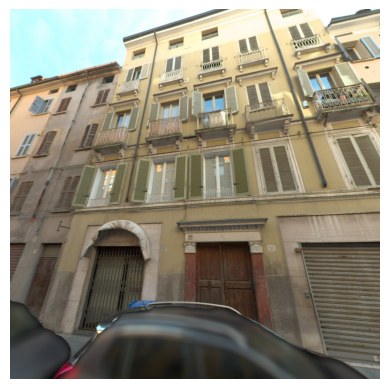

Axis difference: 2.4899071701802313, Facade half-length: 2.3232199629394583
New target: [ 605213.01912085 4962361.72595463], Midpoint: [ 605211.92509283 4962362.11639086]
Distance: 6.955543517214027
101.46084537487259 101.46084537487259
block_0 16 182136664 POINT (605211.9250928299 4962362.116390858) N pano_000116_000042.jpg


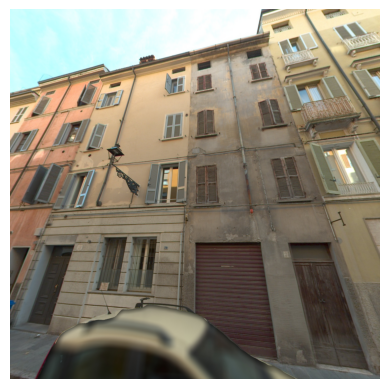

Axis difference: 3.254099677898921, Facade half-length: 2.9136000417098336
New target: [ 605218.23627605 4962359.8863052 ], Midpoint: [ 605216.86190032 4962360.36937627]
Distance: 6.958400460954078
105.82060981430763 105.82060981430763
block_0 15 182136662 POINT (605216.8619003221 4962360.36937627) N pano_000116_000040.jpg


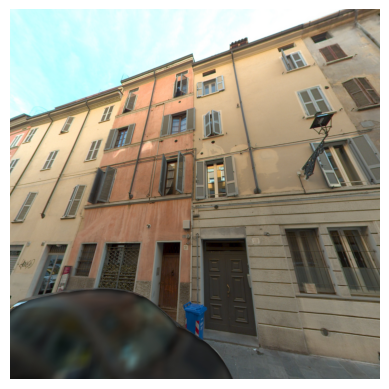

Axis difference: 3.3349763586884364, Facade half-length: 3.05546994975913
New target: [ 605223.92520957 4962357.85715573], Midpoint: [ 605222.48702364 4962358.3725152 ]
Distance: 6.898214699845341
106.14131367973538 106.14131367973538
block_0 165 2427037 POINT (605222.4870236414 4962358.372515196) N pano_000116_000038.jpg


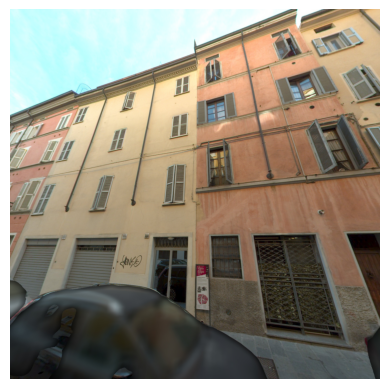

Axis difference: 1.4762579340022057, Facade half-length: 5.011695539709118
New target: [ 605230.08174207 4962355.65232951], Midpoint: [ 605230.08174207 4962355.65232951]
Distance: 6.866247461839499
102.41565316105148 102.41565316105148
block_0 14 182136652 POINT (605230.081742066 4962355.65232951) N pano_000116_000036.jpg


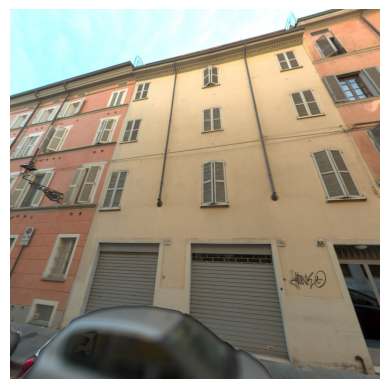

Axis difference: 1.526779142091982, Facade half-length: 7.054893894428406
New target: [ 605241.45522086 4962351.62176411], Midpoint: [ 605241.45522086 4962351.62176411]
Distance: 6.715106888495123
103.14197780300215 103.14197780300215
block_0 28 182136749 POINT (605241.4552208579 4962351.621764114) N pano_000116_000032.jpg


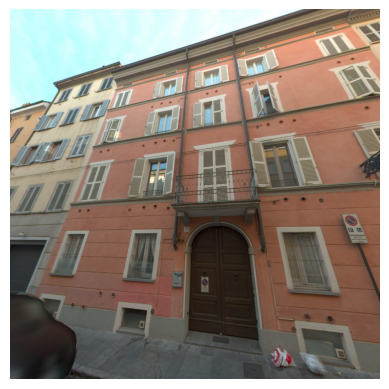

Axis difference: 3.2814227918861434, Facade half-length: 3.2352930258765915
New target: [ 605252.65868927 4962347.58843022], Midpoint: [ 605251.14257721 4962348.15250863]
Distance: 6.738452653557371
105.30750524662774 105.30750524662774
block_0 102 182137892 POINT (605251.1425772081 4962348.152508633) N pano_000116_000028.jpg


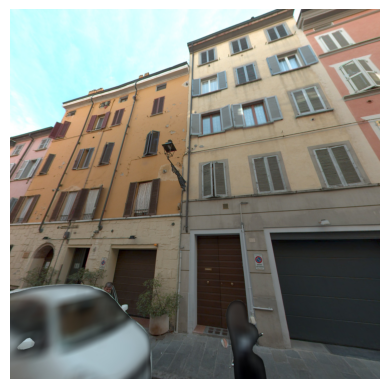

Axis difference: 1.0696760001592338, Facade half-length: 5.1812704723469
New target: [ 605259.052324   4962345.27639977], Midpoint: [ 605259.052324   4962345.27639977]
Distance: 6.787418996361651
99.06743748187495 99.06743748187495
block_0 10 182136612 POINT (605259.0523239998 4962345.276399767) N pano_000116_000026.jpg


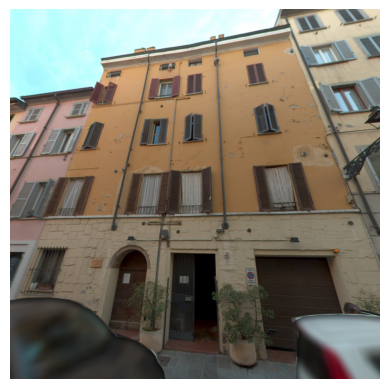

Axis difference: 2.3737861836561933, Facade half-length: 2.4910558961778166
New target: [ 605266.27321382 4962342.68346851], Midpoint: [ 605266.27321382 4962342.68346851]
Distance: 6.5871183459586335
111.12279339870574 111.12279339870574
block_0 72 182137474 POINT (605266.2732138163 4962342.683468508) N pano_000116_000023.jpg


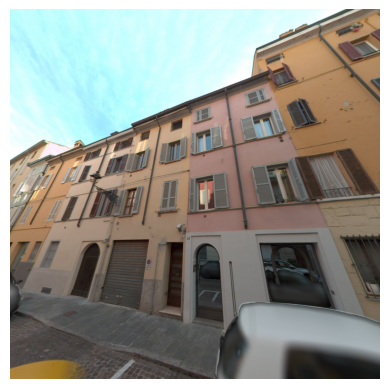

Axis difference: 3.3475958220660686, Facade half-length: 2.501039221979455
New target: [ 605272.13231579 4962340.52936655], Midpoint: [ 605270.96040418 4962340.96574079]
Distance: 6.694371676483456
109.24018466856916 109.24018466856916
block_0 132 182138214 POINT (605270.9604041779 4962340.96574079) N pano_000116_000021.jpg


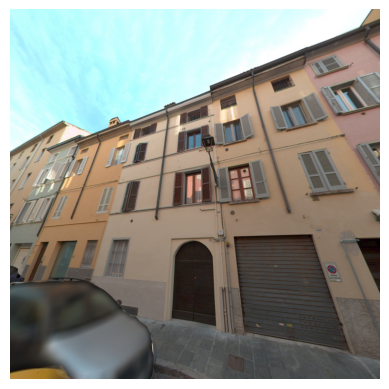

Axis difference: 3.5362996939802542, Facade half-length: 3.488028481071284
New target: [ 605278.22193676 4962338.30682165], Midpoint: [ 605276.58270031 4962338.90221187]
Distance: 6.8587210400801855
106.33641336696488 106.33641336696488
block_0 120 182138080 POINT (605276.582700306 4962338.902211865) N pano_000116_000019.jpg


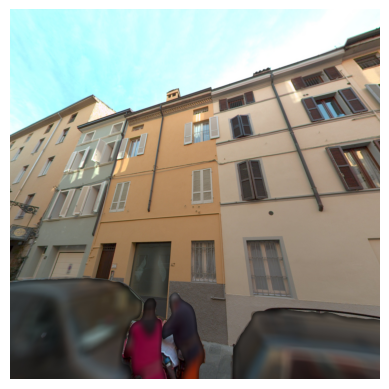

Axis difference: 1.235124705475755, Facade half-length: 2.0252336565039095
New target: [ 605281.76687529 4962337.02596009], Midpoint: [ 605281.76687529 4962337.02596009]
Distance: 6.867029726129836
100.36178121636931 100.36178121636931
block_0 84 182137642 POINT (605281.7668752945 4962337.025960088) N pano_000116_000018.jpg


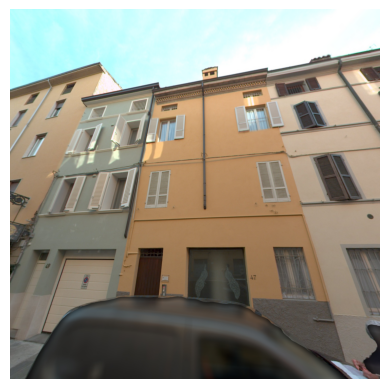

Axis difference: 2.4244874749565497, Facade half-length: 2.7400549310602984
New target: [ 605286.23551253 4962335.37133219], Midpoint: [ 605286.23551253 4962335.37133219]
Distance: 6.7939923279291285
110.90733251616055 110.90733251616055
block_0 115 182137975 POINT (605286.2355125251 4962335.371332195) N pano_000116_000016.jpg


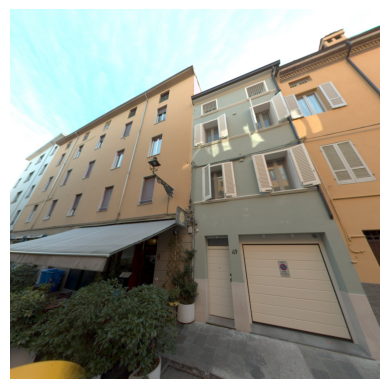

Axis difference: 2.9736155678983778, Facade half-length: 2.7400557109837993
New target: [ 605292.64285281 4962332.94844385], Midpoint: [ 605291.36138443 4962333.43302112]
Distance: 6.831151427496812
104.30827125765035 104.30827125765035
block_0 47 182136877 POINT (605291.3613844321 4962333.433021115) N pano_000116_000014.jpg


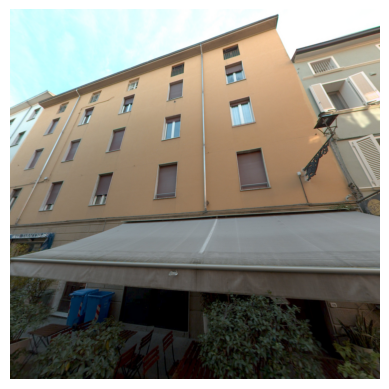

Axis difference: 2.361972637474537, Facade half-length: 7.082136824988627
New target: [ 605300.42502736 4962329.65362083], Midpoint: [ 605300.42502736 4962329.65362083]
Distance: 6.954750618675
109.85372615012041 109.85372615012041
block_0 47 182136877 POINT (605300.4250273625 4962329.653620832) N pano_000116_000011.jpg


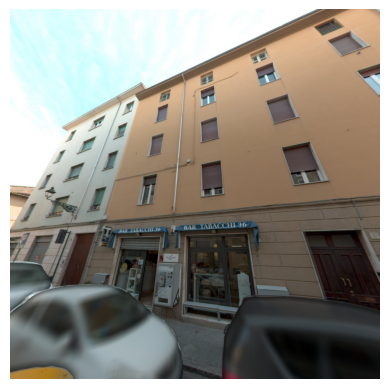

Axis difference: 3.5310086022363976, Facade half-length: 6.744850051420368
New target: [ 605313.1119914  4962324.15577095], Midpoint: [ 605313.1119914  4962324.15577095]
Distance: 7.037213882687413
120 120
block_0 8 182136607 POINT (605313.1119913978 4962324.155770952) N pano_000116_000006.jpg


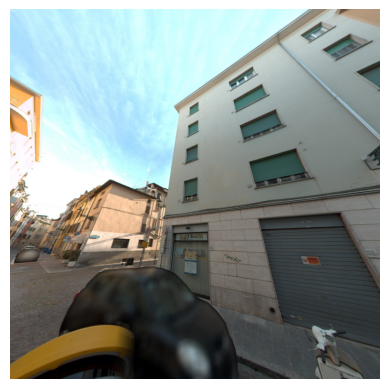

Axis difference: 3.762578443973325, Facade half-length: 2.045035434575985
New target: [ 605322.11250771 4962320.2475802 ], Midpoint: [ 605321.17442156 4962320.65444241]
Distance: 6.762040073109462
115.11543332723086 115.11543332723086
block_0 62 182137189 POINT (605321.1744215561 4962320.654442409) N pano_000116_000003.jpg


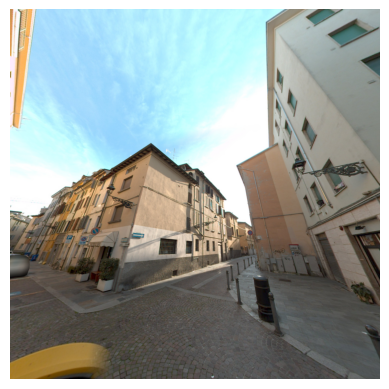

Axis difference: -0.9086041913833469, Facade half-length: 3.2308559546799134
New target: [ 605301.17460419 4962287.99829687], Midpoint: [ 605301.17460419 4962287.99829687]
Distance: 4.247614167854027
77.648453543658 100
block_0 74 182137491 POINT (605301.1746041913 4962287.998296874) S pano_000117_000002.jpg


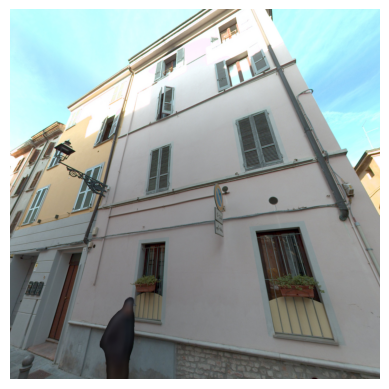

Axis difference: -0.881158982985653, Facade half-length: 6.180631517966062
New target: [ 605292.61115898 4962291.90256438], Midpoint: [ 605292.61115898 4962291.90256438]
Distance: 4.6105502999733
78.98196555707634 100
block_0 162 2427027 POINT (605292.611158983 4962291.902564376) S pano_000117_000005.jpg


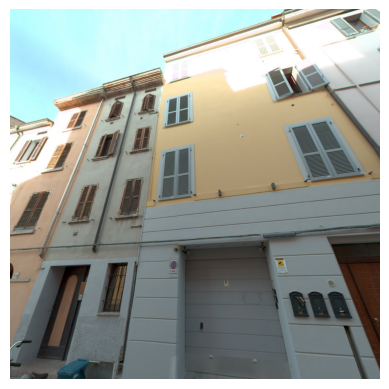

Axis difference: -1.3907103209057823, Facade half-length: 2.335305594928094
New target: [ 605284.86071032 4962295.43125693], Midpoint: [ 605284.86071032 4962295.43125693]
Distance: 4.360002583742973
71.39934959512908 100
block_0 69 182137376 POINT (605284.8607103209 4962295.431256929) S pano_000117_000008.jpg


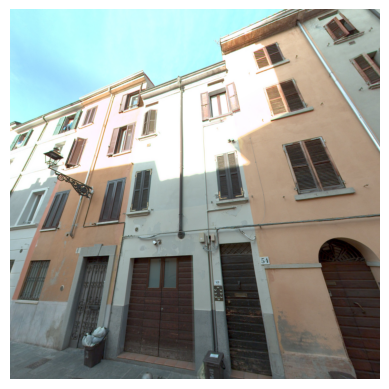

Axis difference: -2.5476998349186033, Facade half-length: 2.375844827995829
New target: [ 605279.50267579 4962297.89911693], Midpoint: [ 605280.58069983 4962297.40009407]
Distance: 4.304112929872523
69.67682697930618 100
block_0 136 182138243 POINT (605280.580699835 4962297.40009407) S pano_000117_000010.jpg


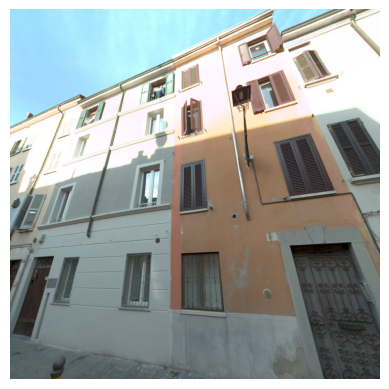

Axis difference: -2.824261464411393, Facade half-length: 3.330868588578282
New target: [ 605275.39226146 4962299.77628883], Midpoint: [ 605275.39226146 4962299.77628883]
Distance: 4.258551736645965
48.45579857422397 100
block_0 1 182136570 POINT (605275.3922614644 4962299.776288828) S pano_000117_000012.jpg


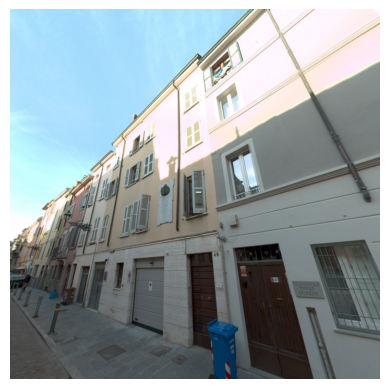

Axis difference: -1.0788577912608162, Facade half-length: 4.596763394743478
New target: [ 605268.17585779 4962303.05818827], Midpoint: [ 605268.17585779 4962303.05818827]
Distance: 4.002336985649004
74.36209489362226 100
block_0 11 182136621 POINT (605268.1758577912 4962303.058188269) S pano_000117_000014.jpg


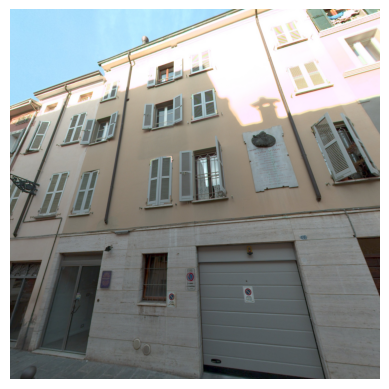

Axis difference: -0.7390605787513778, Facade half-length: 1.8625729602101273
New target: [ 605262.30206058 4962305.74539811], Midpoint: [ 605262.30206058 4962305.74539811]
Distance: 4.078912273244686
79.56088319838649 100
block_0 2 182136574 POINT (605262.3020605787 4962305.74539811) S pano_000117_000016.jpg


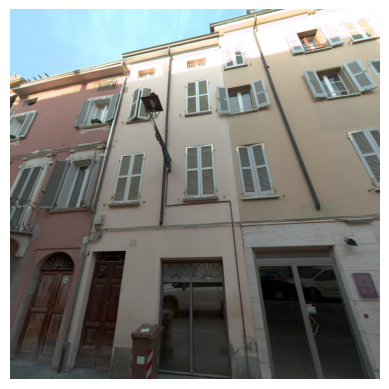

Axis difference: -2.053920418722555, Facade half-length: 2.78068367495748
New target: [ 605258.08192042 4962307.68189634], Midpoint: [ 605258.08192042 4962307.68189634]
Distance: 4.006429326137638
59.15908649556348 100
block_0 119 182138057 POINT (605258.0819204188 4962307.681896344) S pano_000117_000018.jpg


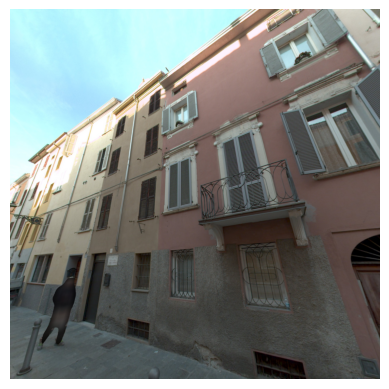

Axis difference: -2.8471693218452856, Facade half-length: 2.4353369019213735
New target: [ 605252.22247195 4962310.33879475], Midpoint: [ 605253.33216932 4962309.83750821]
Distance: 4.329412079580943
65.21484993655741 100
block_0 71 182137460 POINT (605253.3321693218 4962309.837508211) S pano_000117_000020.jpg


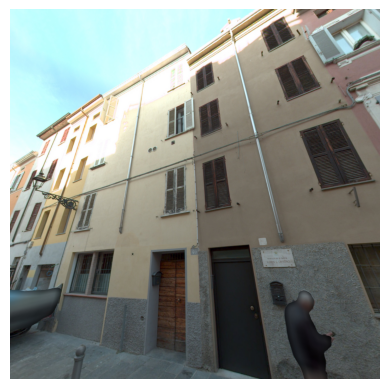

Axis difference: -0.8962439637398347, Facade half-length: 2.8236151841144426
New target: [ 605248.55024396 4962312.02593102], Midpoint: [ 605248.55024396 4962312.02593102]
Distance: 4.424651902819287
78.31347792383185 100
block_0 166 2427043 POINT (605248.5502439637 4962312.025931019) S pano_000117_000021.jpg


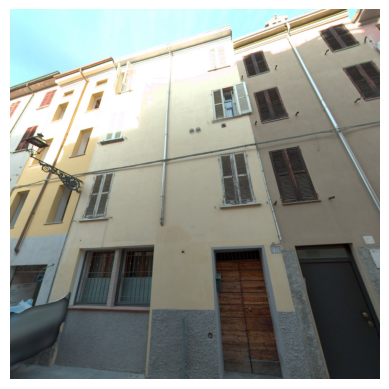

Axis difference: -2.4605539590120316, Facade half-length: 1.6940794951675489
New target: [ 605243.64597426 4962314.1984646 ], Midpoint: [ 605244.42655396 4962313.86956999]
Distance: 4.600817989903869
68.27608236706736 100
block_0 110 182137952 POINT (605244.426553959 4962313.869569985) S pano_000117_000023.jpg


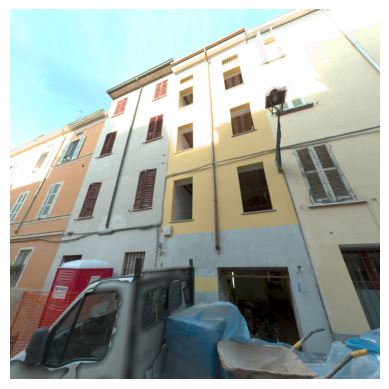

Axis difference: -1.0005629932275042, Facade half-length: 2.8072303017924467
New target: [ 605240.20856299 4962315.43388444], Midpoint: [ 605240.20856299 4962315.43388444]
Distance: 4.2454739101369965
76.36843318047544 100
block_0 26 182136738 POINT (605240.2085629932 4962315.433884441) S pano_000117_000024.jpg


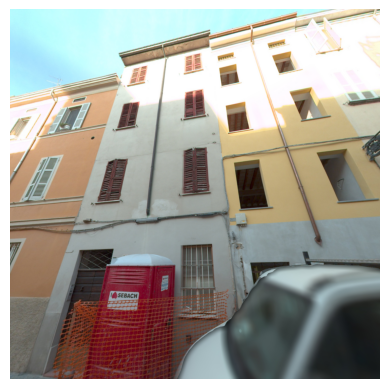

Axis difference: -2.7292719583492726, Facade half-length: 1.134754915273321
New target: [ 605236.04954223 4962317.14083594], Midpoint: [ 605236.55027196 4962316.87402718]
Distance: 3.8174116253523667
52.79849612467425 100
block_0 182 2427083 POINT (605236.5502719583 4962316.874027181) S pano_000117_000026.jpg


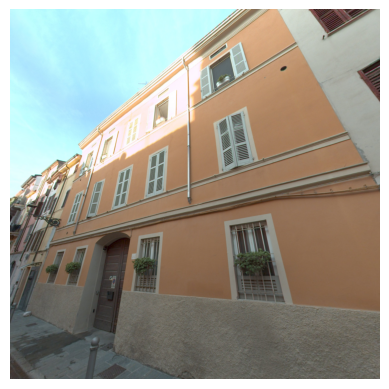

Axis difference: -1.3591200548689812, Facade half-length: 6.357556121487909
New target: [ 605229.80112005 4962320.12472981], Midpoint: [ 605229.80112005 4962320.12472981]
Distance: 3.3763616610987954
66.2629480616248 110
block_0 182 2427083 POINT (605229.8011200549 4962320.1247298075) S pano_000117_000028.jpg


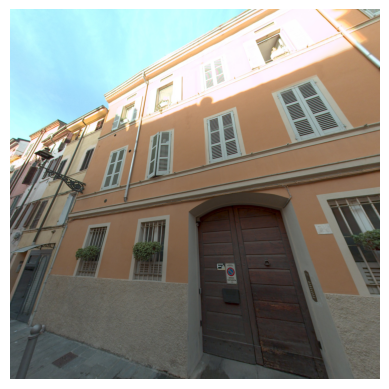

Axis difference: -2.263095326256007, Facade half-length: 1.7626529066256826
New target: [ 605221.66192918 4962323.96936185], Midpoint: [ 605222.45909533 4962323.59351287]
Distance: 3.5835365519397766
65.07425438877785 100
block_0 103 182137901 POINT (605222.4590953263 4962323.593512869) S pano_000117_000031.jpg


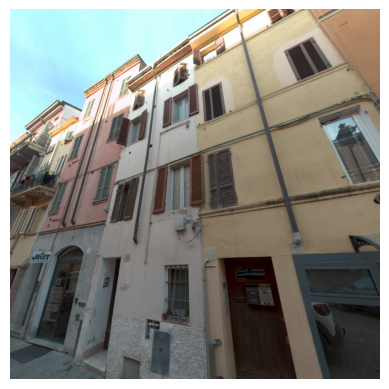

Axis difference: -1.8277128094341606, Facade half-length: 1.8316905691392797
New target: [ 605219.20671281 4962325.12364502], Midpoint: [ 605219.20671281 4962325.12364502]
Distance: 3.6156215420704694
59.63515483737338 100
block_0 101 182137853 POINT (605219.2067128094 4962325.123645015) S pano_000117_000032.jpg


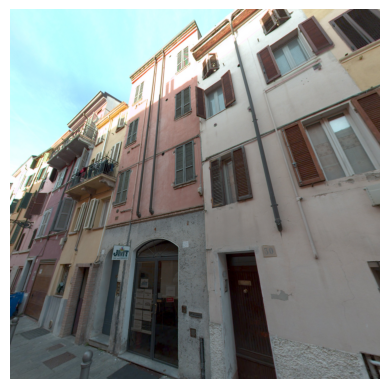

Axis difference: -1.2315800567157567, Facade half-length: 1.891088891494116
New target: [ 605215.80058006 4962326.62348386], Midpoint: [ 605215.80058006 4962326.62348386]
Distance: 3.704216370976014
70.58059325389885 100
block_0 87 182137654 POINT (605215.8005800567 4962326.623483861) S pano_000117_000033.jpg


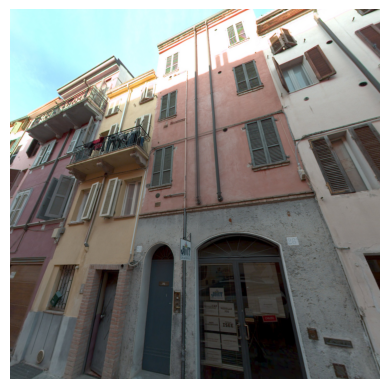

Axis difference: -0.7069364334456623, Facade half-length: 1.6845579771901396
New target: [ 605212.48793643 4962327.96929556], Midpoint: [ 605212.48793643 4962327.96929556]
Distance: 3.742667036302111
79.1122355839789 100
block_0 78 182137556 POINT (605212.4879364334 4962327.969295556) S pano_000117_000034.jpg


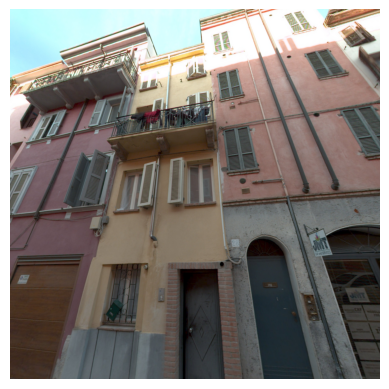

Axis difference: -2.405965826124884, Facade half-length: 2.5097100273333384
New target: [ 605208.58296583 4962329.49986359], Midpoint: [ 605208.58296583 4962329.49986359]
Distance: 3.659093933225462
48.888195252449016 100
block_0 60 182137110 POINT (605208.5829658262 4962329.49986359) S pano_000117_000036.jpg


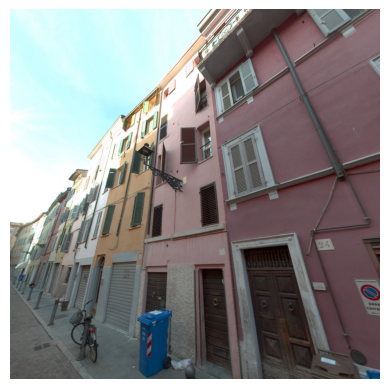

Axis difference: -1.2449102365644649, Facade half-length: 1.7245121962842356
New target: [ 605204.64591024 4962331.05768677], Midpoint: [ 605204.64591024 4962331.05768677]
Distance: 3.3134451510259897
67.93150399076363 110
block_0 95 182137766 POINT (605204.6459102365 4962331.057686775) S pano_000117_000037.jpg


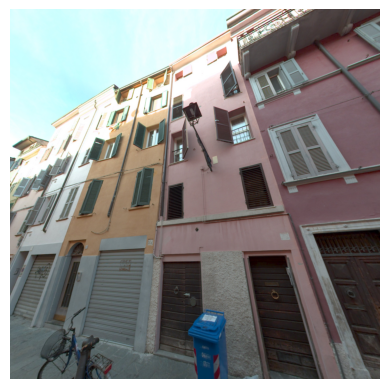

Axis difference: -0.46562394546344876, Facade half-length: 2.1173364984924423
New target: [ 605201.08262395 4962332.49384889], Midpoint: [ 605201.08262395 4962332.49384889]
Distance: 3.2474036295353987
81.75632028255295 110
block_0 90 182137721 POINT (605201.0826239454 4962332.493848888) S pano_000117_000038.jpg


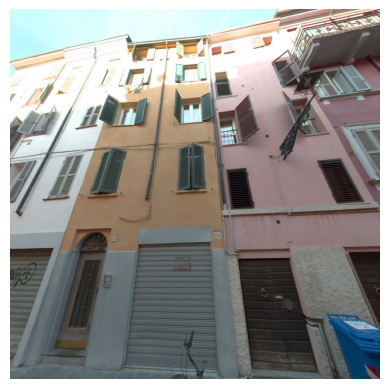

Axis difference: -2.2691287781344727, Facade half-length: 1.8525616939695049
New target: [ 605196.5362013  4962334.31115492], Midpoint: [ 605197.39612878 4962333.96688622]
Distance: 3.11144691901218
60.32555113080561 110
block_0 114 182137972 POINT (605197.3961287781 4962333.966886216) S pano_000117_000040.jpg


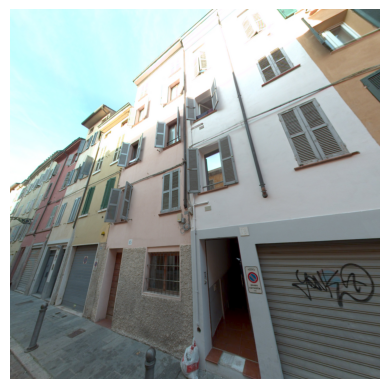

Axis difference: -1.2367396365152672, Facade half-length: 2.2285555549265887
New target: [ 605193.61373964 4962335.499469  ], Midpoint: [ 605193.61373964 4962335.499469  ]
Distance: 2.718123451019835
62.9352204327723 110
block_0 96 182137768 POINT (605193.6137396365 4962335.499468997) S pano_000117_000041.jpg


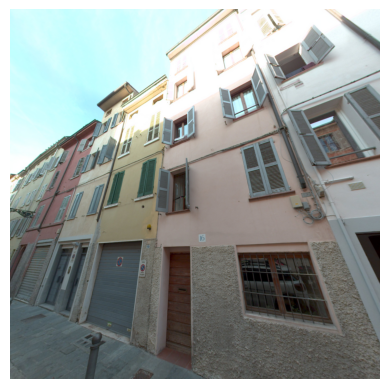

Axis difference: 19.957788045168854, Facade half-length: 13.80832173516298
New target: [ 605182.71286808 4962281.51993078], Midpoint: [ 605189.01021195 4962278.68957791]
Distance: 50.89569322532305
120 120


In [44]:
def calculate_new_target(midpoint_coords, facade_start, facade_end, camera_coords, orientation):
    """
    Calculate a new target based on the camera's position relative to the midpoint and facade's start or end,
    depending on whether the camera surpasses the midpoint along the relevant axis (x or y).
    
    Parameters:
    - midpoint_coords: (x, y) coordinates of the midpoint (ignore z)
    - facade_start: (x, y) coordinates of one endpoint of the facade segment
    - facade_end: (x, y) coordinates of the other endpoint of the facade segment
    - camera_coords: (x, y) coordinates of the camera
    - orientation: The facade's orientation (N, S -> x-axis; E, W -> y-axis)
    
    Returns:
    - new_target_coords: The new target coordinates (x, y) or the original midpoint if the condition isn't met.
    """
    # Convert to numpy arrays for vector calculations
    midpoint = np.array(midpoint_coords[:2])
    facade_start = np.array(facade_start[:2])
    facade_end = np.array(facade_end[:2])
    camera = np.array(camera_coords[:2])

    # Calculate the length of the facade segment
    facade_length = np.linalg.norm(facade_end - facade_start)

    # Determine if we should compare x-coordinates (for N/S) or y-coordinates (for E/W)
    if orientation in ['N', 'S']:
        # Compare x-coordinates
        axis_diff = camera[0] - midpoint[0]  # Negative if before the midpoint, positive if after
    elif orientation in ['E', 'W']:
        # Compare y-coordinates
        axis_diff = camera[1] - midpoint[1]  # Negative if before the midpoint, positive if after
    else:
        return midpoint  # Return the original midpoint if orientation is unknown

    print(f"Axis difference: {axis_diff}, Facade half-length: {facade_length / 2}")

    # Calculate the distance between the camera and the two extremes of the facade
    dist_to_start = np.linalg.norm(facade_start - camera)
    dist_to_end = np.linalg.norm(facade_end - camera)

    if np.abs(axis_diff) > facade_length / 2:
        # Choose the closest point (either facade_start or facade_end)
        if dist_to_start < dist_to_end:
            new_target = (midpoint + facade_start) / 2  # Midpoint between facade midpoint and facade_end
        else:
            new_target = (midpoint + facade_end) / 2  # Midpoint between facade midpoint and facade_start
    else:
        new_target = midpoint # Camera is within the threshold, use the original midpoint

    print(f"New target: {new_target}, Midpoint: {midpoint}")

    return new_target


for i, row in gdf_combined.iterrows():
    # Camera and target coordinates (2D only, ignoring z)
    camera_coords = (row.loc['X'], row.loc['Y'], row.loc['Z'])  # Camera position (x, y, z)
    midpoint_coords = (row.loc['geometry_midpoint'].x, row.loc['geometry_midpoint'].y, row.loc['Z'])  # Target position (x, y, z)

    # Facade segment extremes (ensure only x, y are considered)
    facade_start = (row.loc['geometry_outer_edge'].coords[0][:2])  # One end of the facade segment (x, y)
    facade_end = (row.loc['geometry_outer_edge'].coords[-1][:2])  # The other end of the facade segment (x, y)

    # Retrieve facade orientation from the data (assumed to be in row['orientation_outer_edge'])
    orientation = row.loc['orientation_outer_edge']

    # Calculate a new target based on the facade segment and camera's position
    new_target_coords = calculate_new_target(midpoint_coords, facade_start, facade_end, camera_coords, orientation)
    new_target_coords = (new_target_coords[0], new_target_coords[1], row.loc['Z'])  # Reintroduce z coordinate
    
    # Calculate yaw and pitch using the new target
    yaw, pitch = calculate_yaw_pitch(camera_coords, new_target_coords)

    # Adjust pitch (fixed value for now)
    pitch_adjustment = 25  # degrees
    pitch += pitch_adjustment

    # Calculate dynamic FoV based on vectors
    v1, v2 = calculate_vectors(camera_coords, new_target_coords)
    calculated_fov = calculate_dynamic_fov(v1, v2)

    # Adjust FoV based on the distance between camera and midpoint
    fov, distance = adjust_fov_based_on_distance(camera_coords, midpoint_coords, calculated_fov)

    print(calculated_fov, fov)

    if distance > 20:
        break  # Skip further processing if the camera is too far from the target

    # Path to the image
    path = row.loc['PATH']
    run = row.loc['RUN']
    image_name = row.loc['FOTO']
    image_path = '{}{}/{}/{}'.format(images_folder, path, run, image_name)
    image = cv2.imread(image_path)

    # Convert the original image to RGB before any further processing
    rgb_image = convert_bgr_to_rgb(image)

    # Parameters for perspective projection
    roll = row.loc['Roll']

    output_image_shape = 'squared'  # 'squared', 'horizontal' or 'vertical'
    if output_image_shape == 'squared':
        output_width = 1024
        output_height = 1024
    elif output_image_shape == 'horizontal':
        output_width = 1024
        output_height = 512
    elif output_image_shape == 'vertical':
        output_width = 512
        output_height = 1024

    # Apply the transformation
    output_image = enhanced_equirectangular_to_perspective(rgb_image, fov, yaw, pitch, roll, output_height, output_width)

    print(row.loc['group_id'], row.loc['building_id'], row.loc['osm_id'], row.loc['geometry_midpoint'], row.loc['orientation_midpoint'], image_name)

    # Display the transformed image
    plt.imshow(output_image)
    plt.axis('off')  # Hide the axes
    plt.show()

    # Close the figure to prevent old plots from showing up again
    plt.close('all')  # Close all figures
